# In this Jupyter notebook we will show the image processing pipeline used to quantify adhesion.

In [159]:
#importing the packages used
import numpy as np
import matplotlib.pyplot as plt
import statistics as st
import scipy.stats as stats
import pandas as pd
from skimage.morphology import square
from skimage.measure import label, regionprops
from matplotlib.collections import PatchCollection
import matplotlib.patches as mpatches
from matplotlib.axes import Axes
from skimage.filters import threshold_otsu
import skimage.io
import skimage.filters
import skimage.measure
import seaborn as sns
import re
import os
import sys
sys.path.append('/Users/bencekover/Library/CloudStorage/OneDrive-Personal/MSci Bahler lab/S.-Pombe-MLPs - Github/')
import yeastmlptrial.adhesion as adh
root = "/Users/bencekover/Library/CloudStorage/OneDrive-Personal/MSci Bahler lab/S.-Pombe-MLPs - Github/"
plt.rcParams["font.family"] = "Arial"



# Import strain layouts

In [160]:
#Get the layout of the strains, make a vector of strain names in order (by row so A1, A2, etc.)

old_wild_isolate_map = root + "internal data/Old wild strain map.xlsx"
new_wild_isolate_map = root + "internal data/final wild strain map.xlsx"
segregant_map = root + "internal data/segregant_strains_map.xlsx"
mimi_cris_map = root + "internal data/strains_mimi_cris.xlsx"


    


# Assembling dataframes

### Wild isolates on EMM

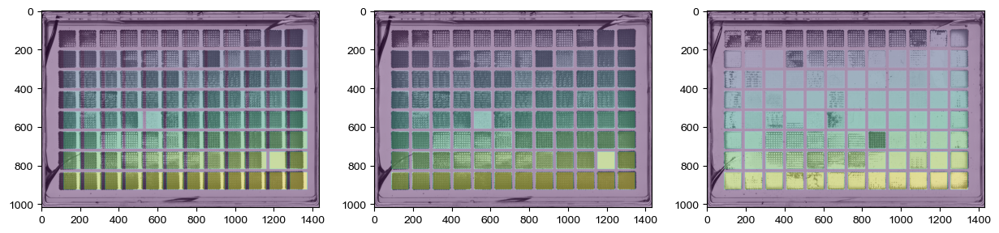

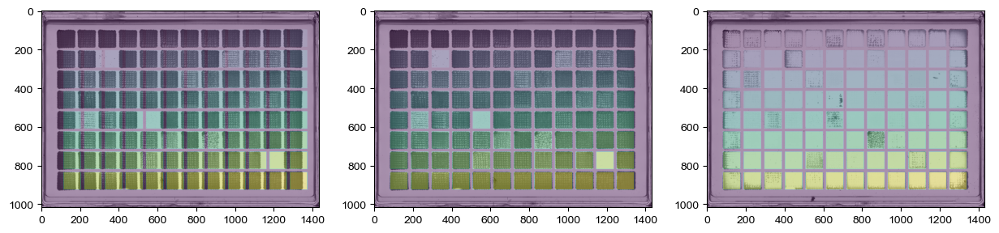

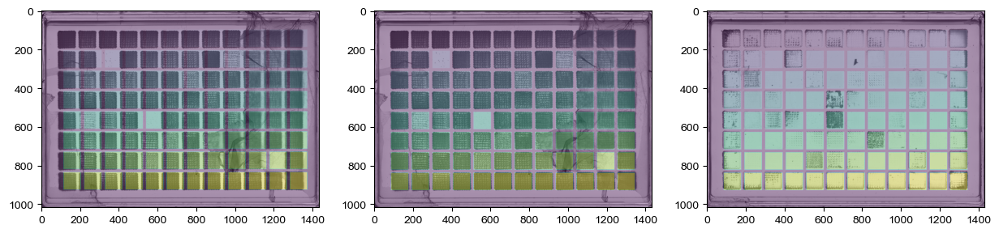

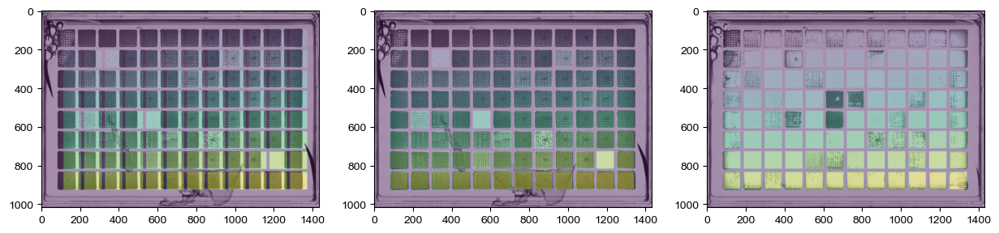

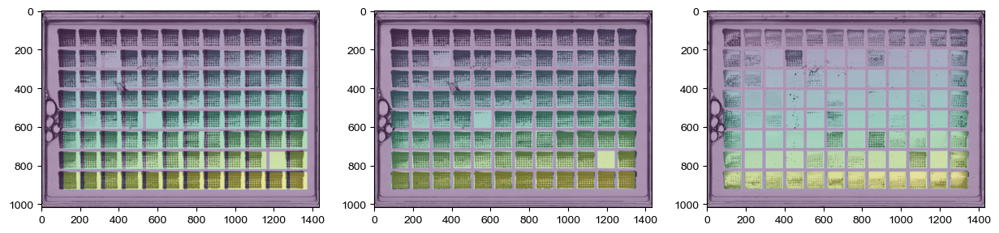

...

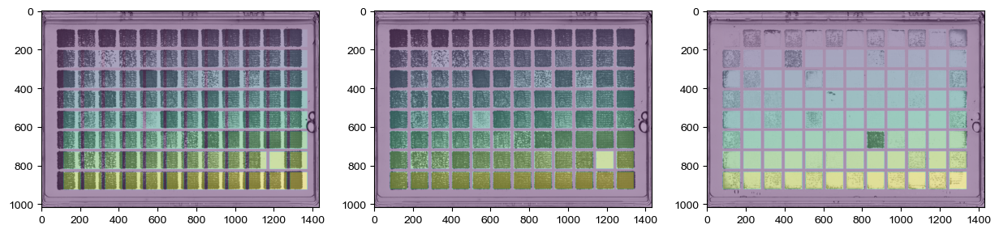

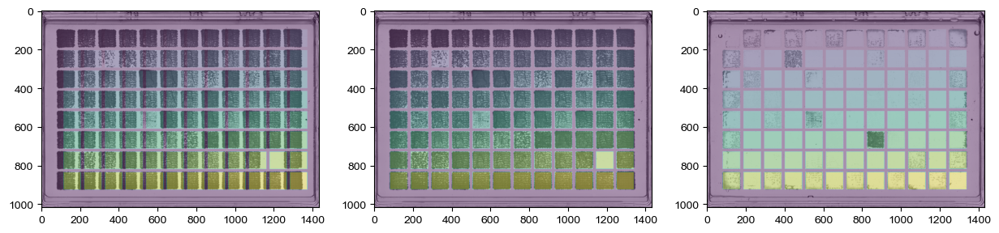

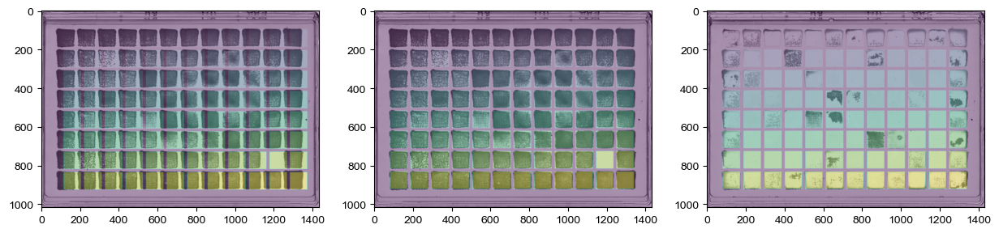

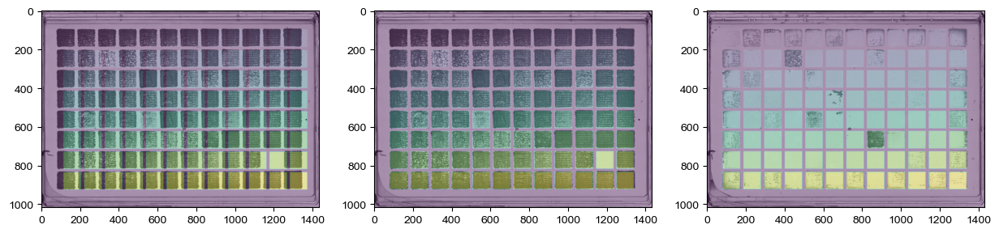

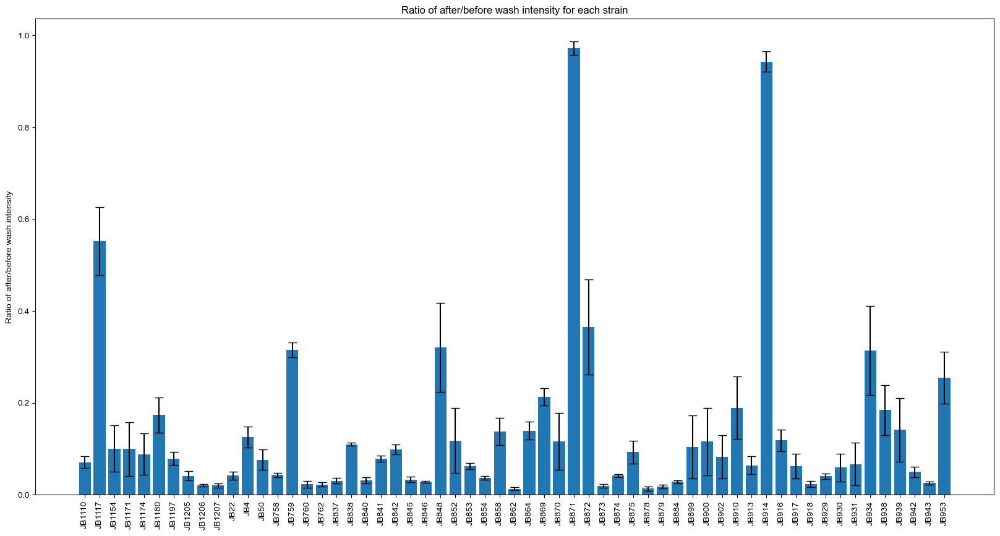

,strain,ratio,before_wash,after_wash,sem,filtered_all_ratio_vals,n
0,JB1110,0.070499,0.179559,0.011684,0.012804,"[0.04863660012534467, 0.05085361217741597, 0.1...",6
1,JB1117,0.552306,0.419815,0.220422,0.073884,"[0.8248077876204156, 0.2393587998651804, 0.227...",10
2,JB1154,0.100075,0.384892,0.034390,0.050612,"[0.5544813920955884, 0.03438858803310515, 0.04...",10
3,JB1171,0.099025,0.377828,0.031157,0.058807,"[0.62717501286687, 0.03492674656537147, 0.0492...",10
4,JB1174,0.088119,0.401425,0.030740,0.044971,"[0.4849635369763452, 0.031195400825644086, 0.1...",10


In [161]:

image_for_raw_layout = root + "internal data/google drive data/scanner/20220627_biofilm_JB50_7x7/20220627_1_biofilm_JB50_7x7.jpg"
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM_after"
wild_isolate_emm =  adh.result_from_folders_of_ims(folder1,folder2, new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_emm)
wild_isolate_emm.to_csv(root + "Bence folder/Image processing - Adhesion assay/wild_isolate_emm.csv")
wild_isolate_emm.head()

### Wild isolates on YES

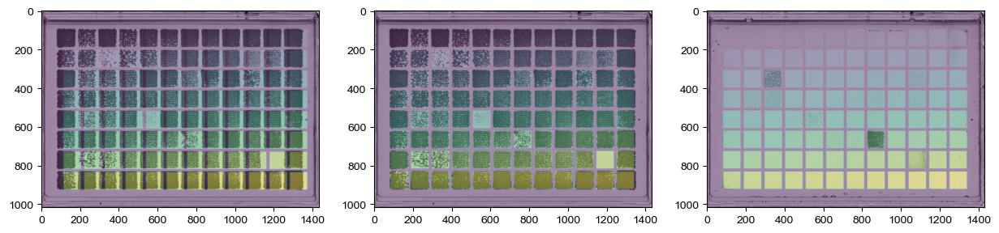

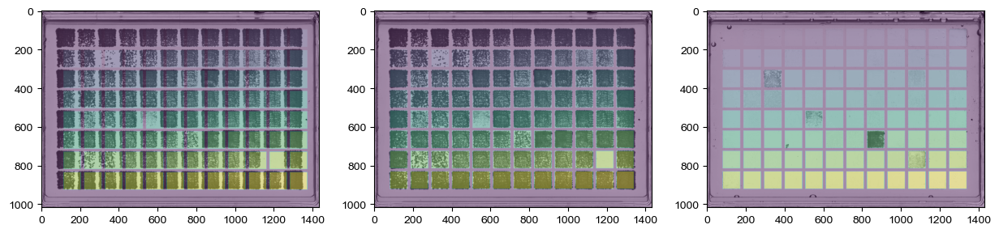

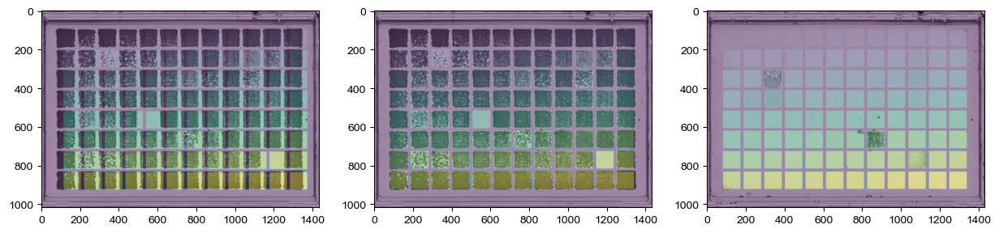

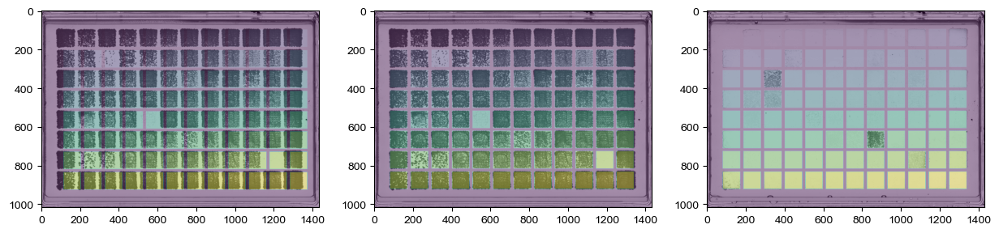

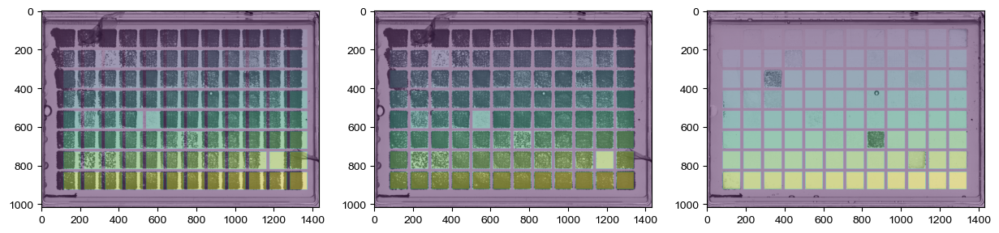

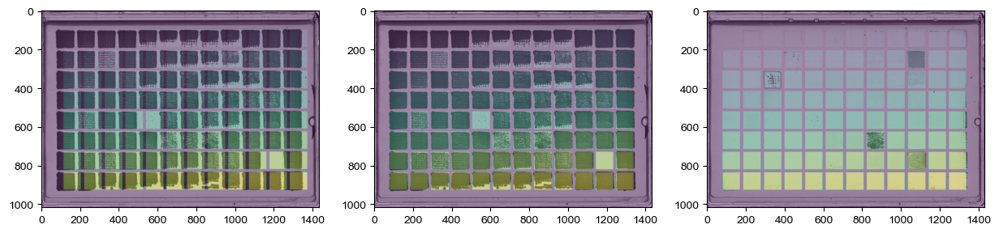

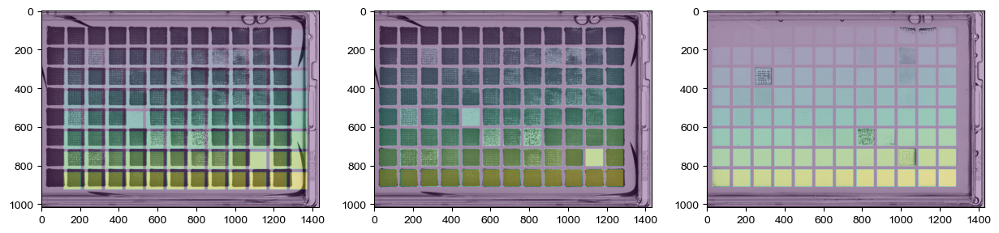

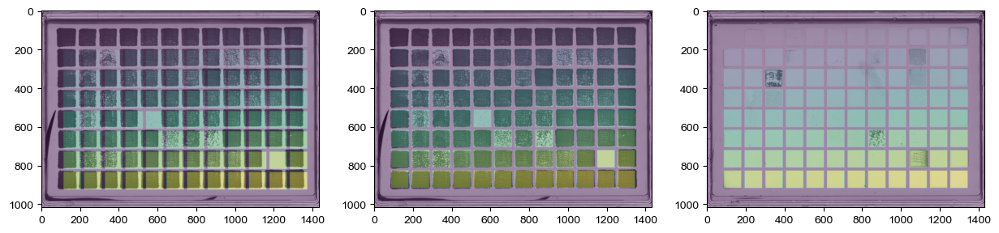

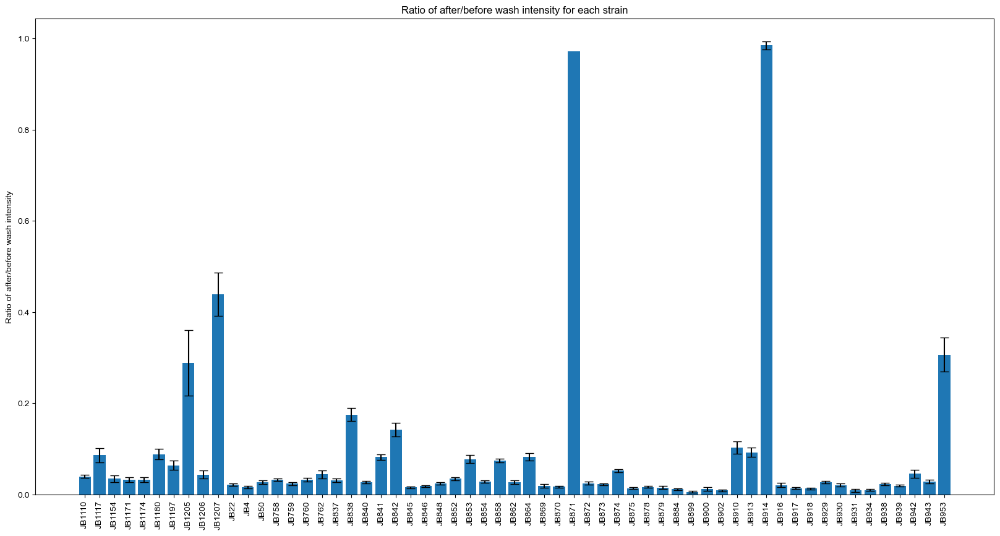

,strain,ratio,before_wash,after_wash,sem,filtered_all_ratio_vals,n
0,JB1110,0.039633,0.206972,0.008122,0.003419,"[0.032805330753829375, 0.043357439977907086, 0...",3
1,JB1117,0.086264,0.394245,0.032562,0.015287,"[0.11081204729957614, 0.07660071368775243, 0.0...",8
2,JB1154,0.034612,0.420602,0.013682,0.006862,"[0.06454490624865701, 0.049879709760482276, 0....",8
3,JB1171,0.032253,0.413781,0.013373,0.005467,"[0.056696997502166425, 0.03621708604228008, 0....",8
4,JB1174,0.032509,0.436838,0.014307,0.005314,"[0.05294102574256499, 0.03712268681965578, 0.0...",8


In [162]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES_after"
wild_isolate_yes =  adh.result_from_folders_of_ims(folder1,folder2, new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_yes)
wild_isolate_yes.to_csv(root + "Bence folder/Image processing - Adhesion assay/wild_isolate_yes.csv")
wild_isolate_yes.head()

# Wild isolates from Cris and Mimi on EMM - to see whether strains were scrambled



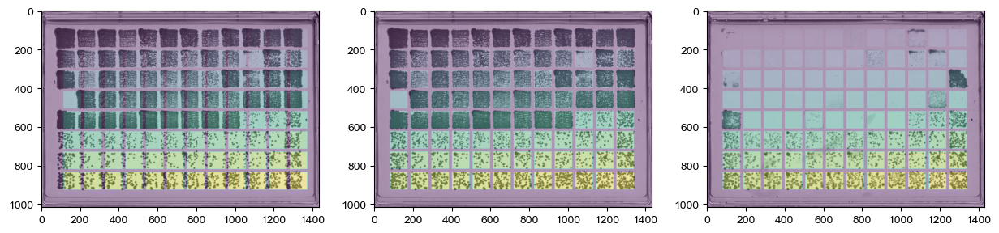

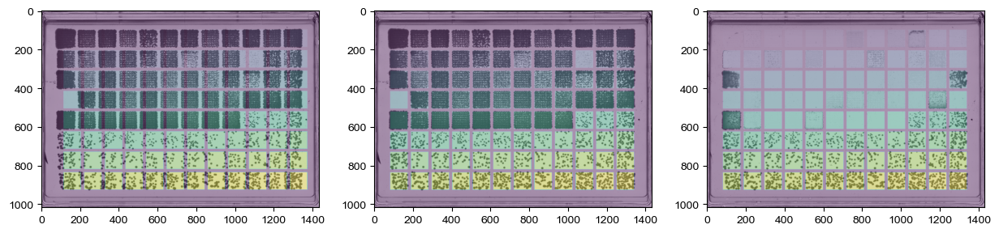

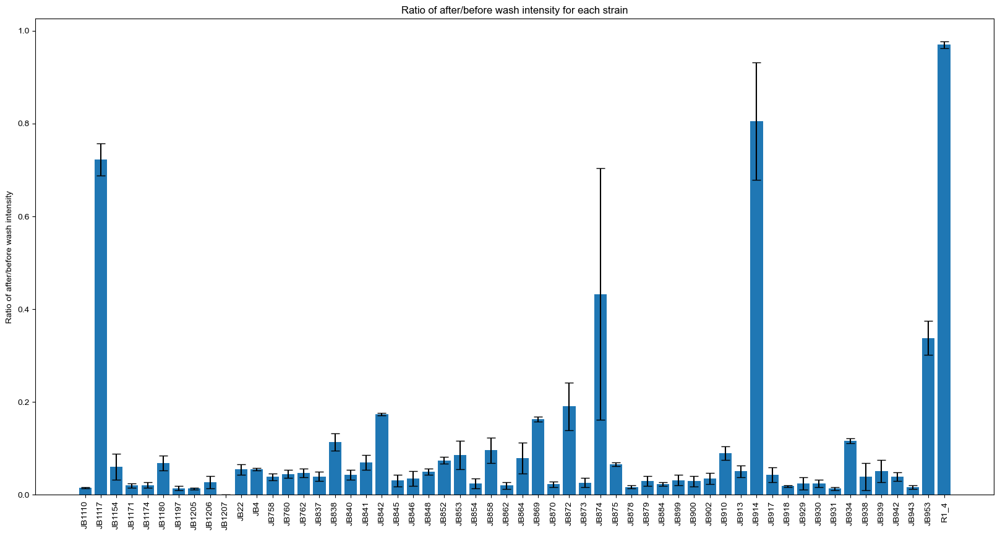

In [163]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates (MIMI)_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates (MIMI)_EMM_after"
wild_isolate_mimi_emm =  adh.result_from_folders_of_ims(folder1,folder2, mimi_cris_map, image_for_raw_layout,keep_all=True)
adh.barchart_from_res(wild_isolate_mimi_emm)



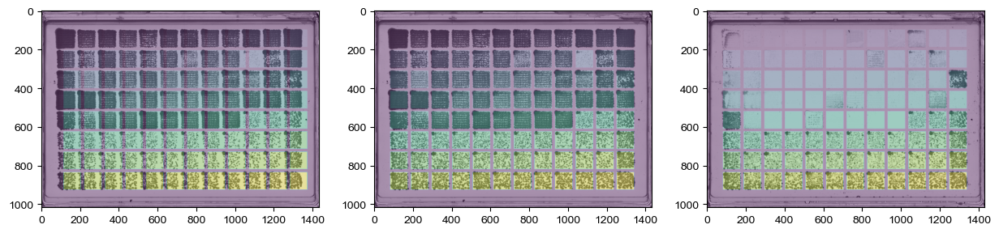

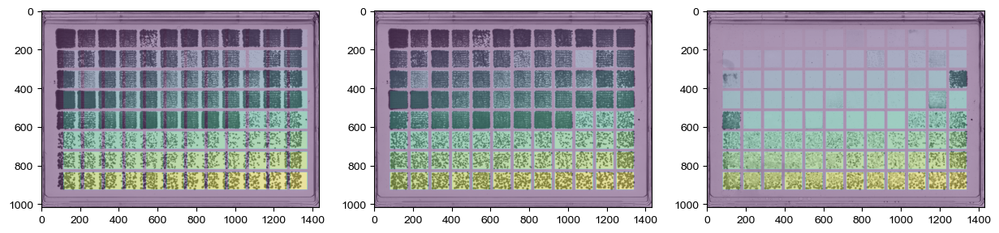

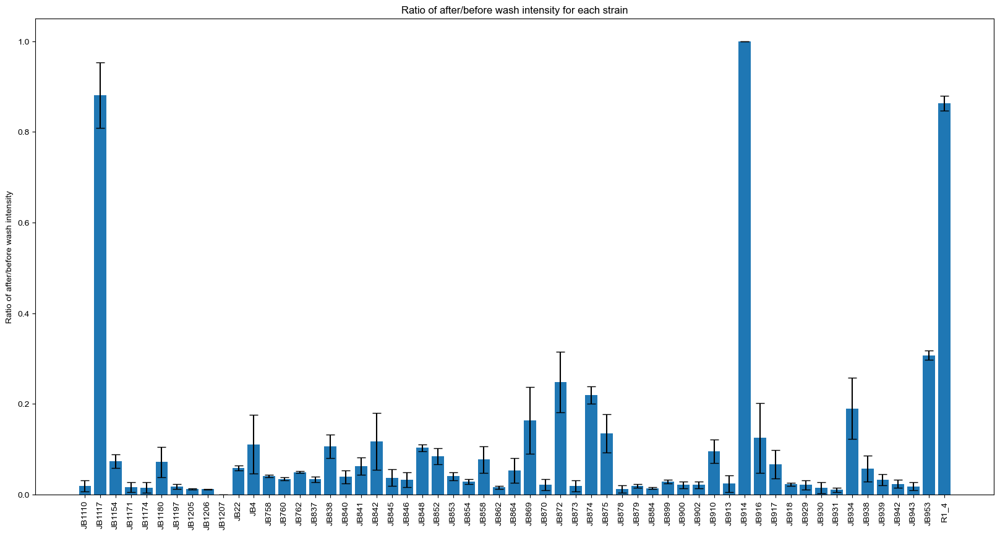

In [164]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates (CRIS)_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates (CRIS)_EMM_after"
wild_isolate_cris_emm =  adh.result_from_folders_of_ims(folder1,folder2, mimi_cris_map, image_for_raw_layout,keep_all=True)
adh.barchart_from_res(wild_isolate_cris_emm)




## Wild isolates on Caf

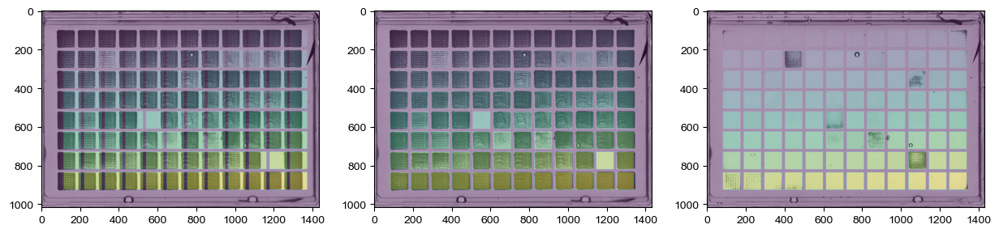

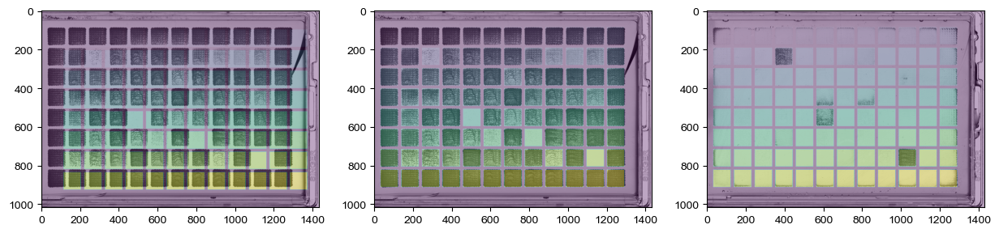

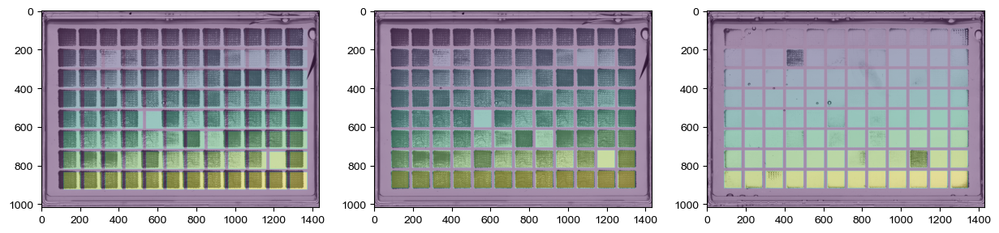

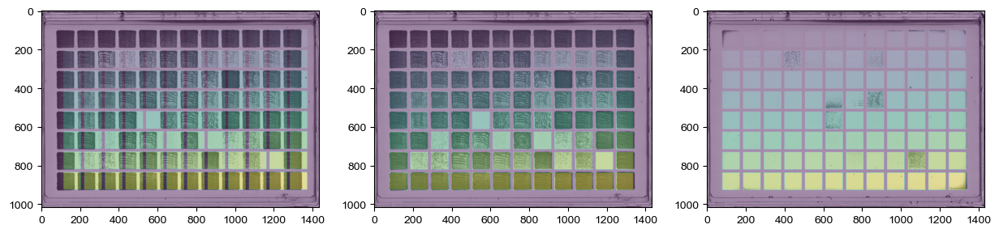

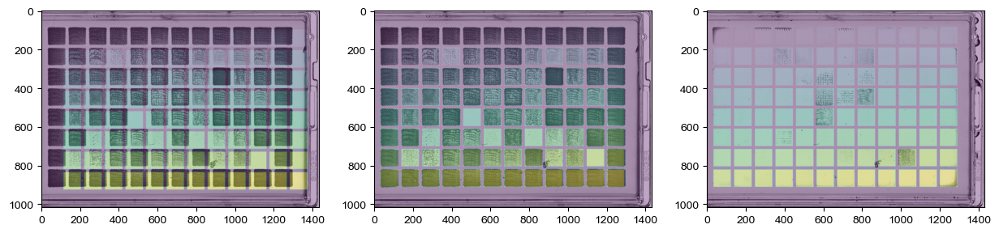

...

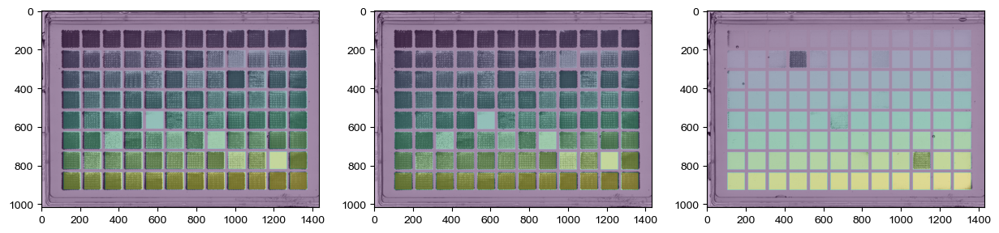

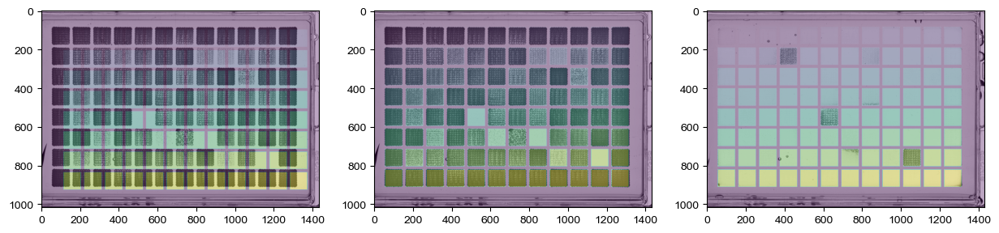

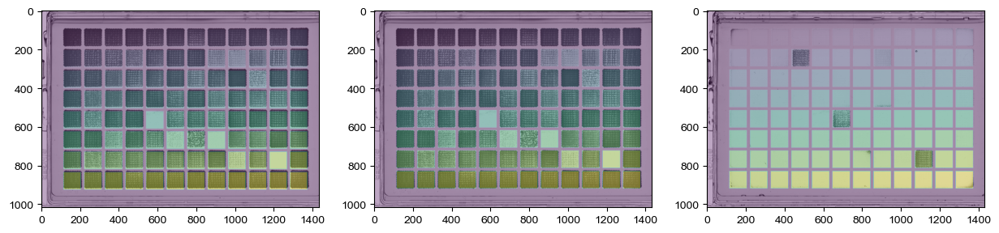

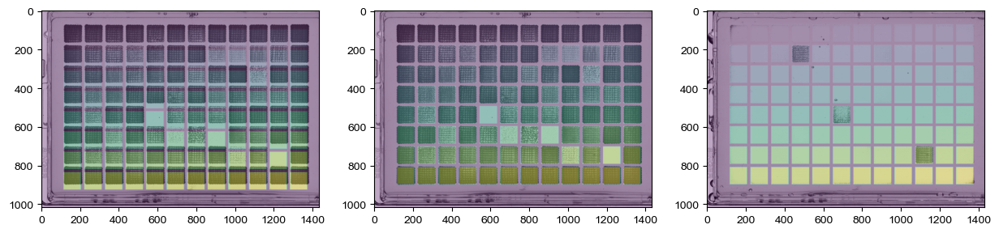

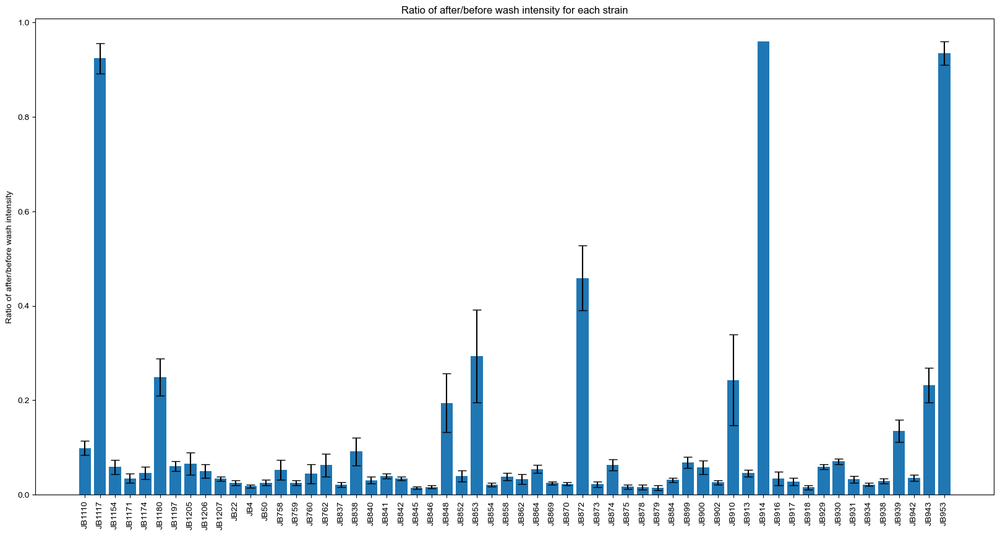

In [165]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine_after"
wild_isolate_yes_caf =  adh.result_from_folders_of_ims(folder1,folder2, new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_yes_caf)


# Wild isolates on Rap 

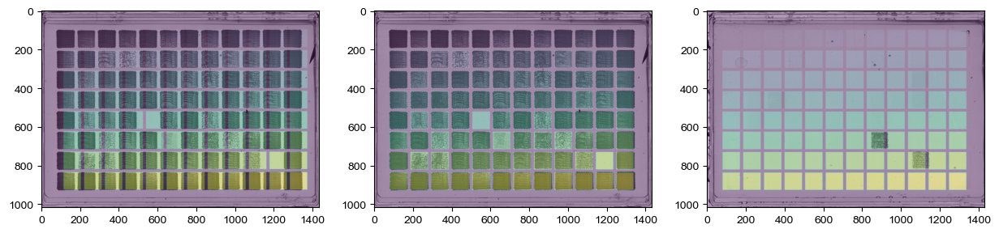

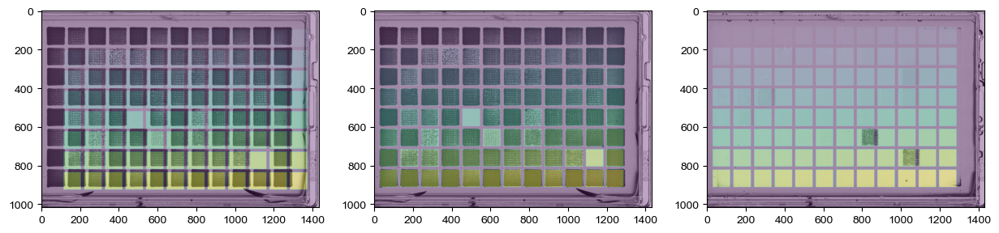

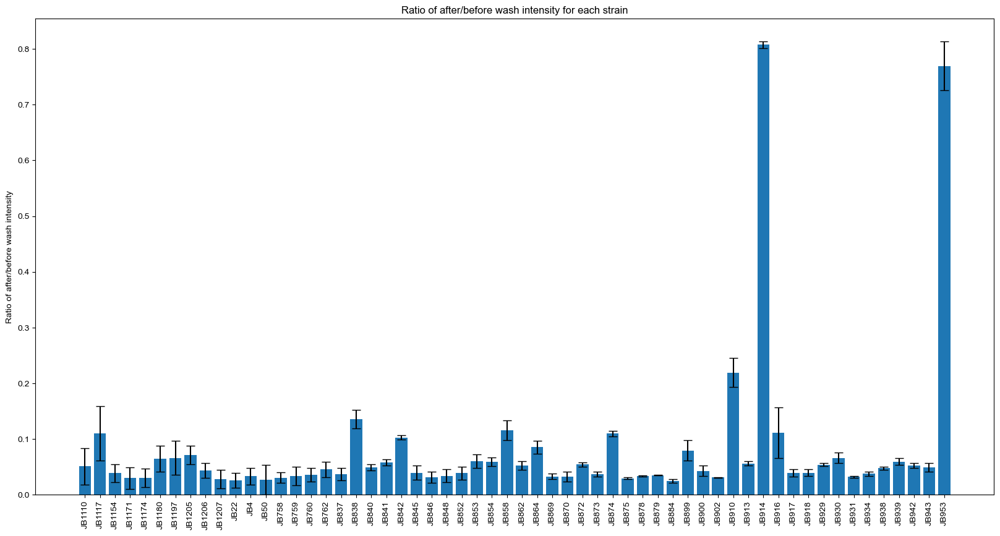

In [166]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Rapamycin_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Rapamycin_after"
wild_isolate_yes_rap =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_yes_rap)


# Wild isolates on caffeine and rapamycin




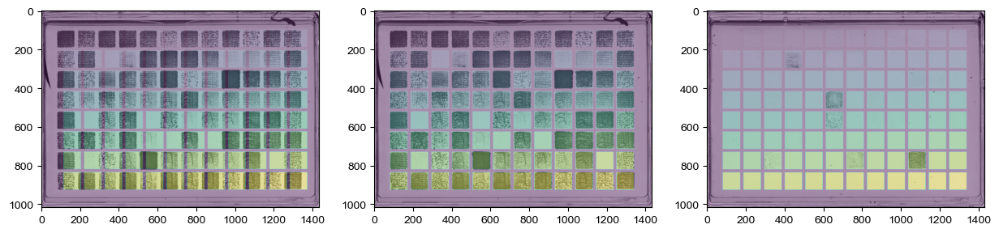

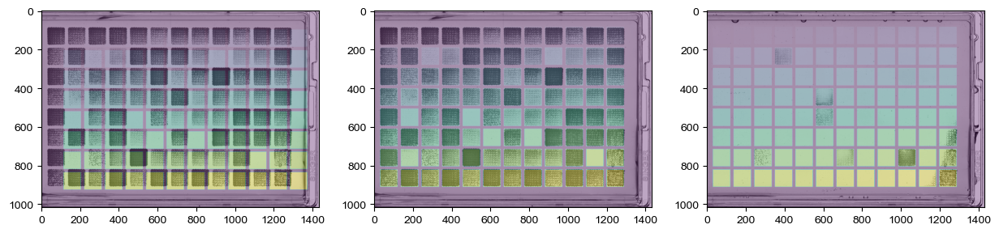

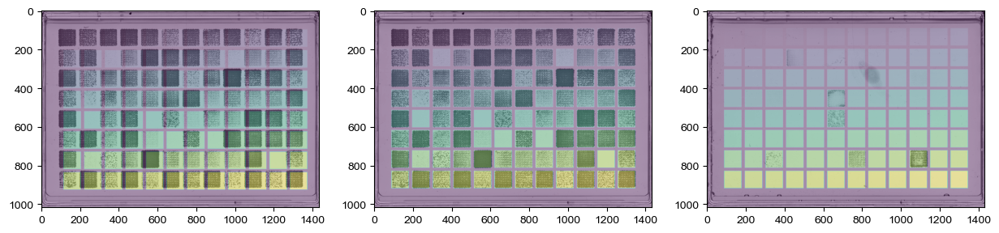

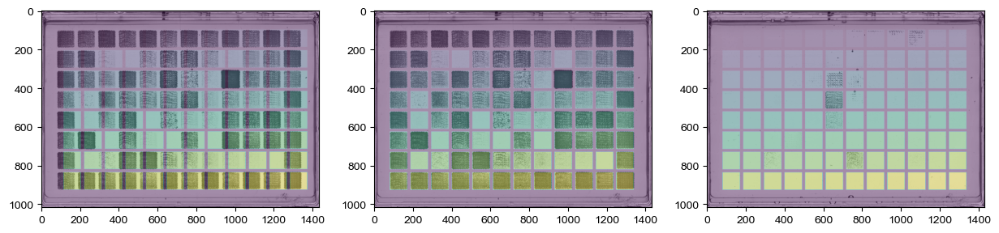

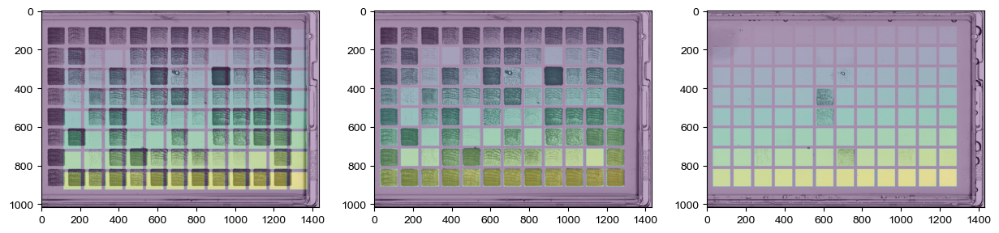

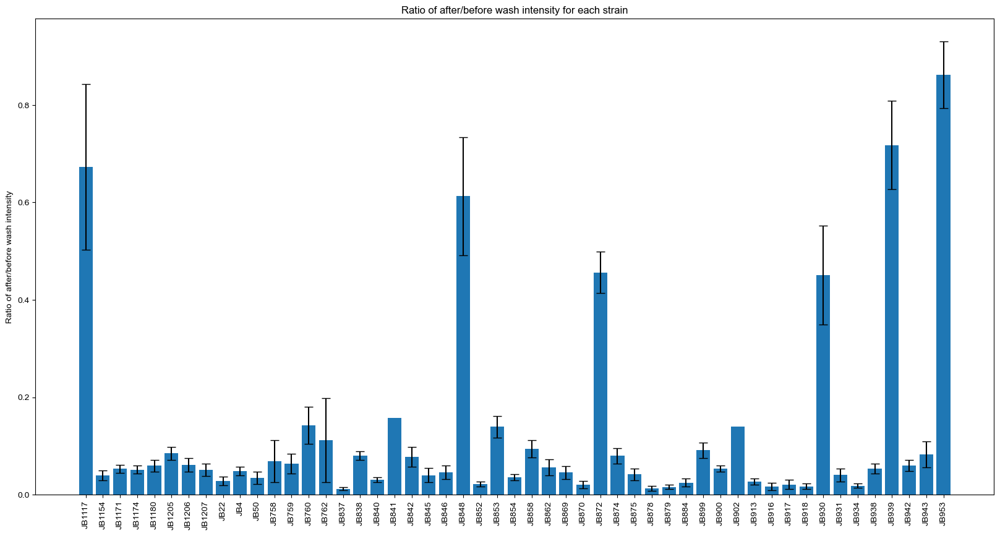

In [167]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine + Rapamycin_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + Caffeine + Rapamycin_after"
wild_isolate_yes_caf_rap =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_yes_caf_rap)

# Wild isolates EMM hydrogen peroxide


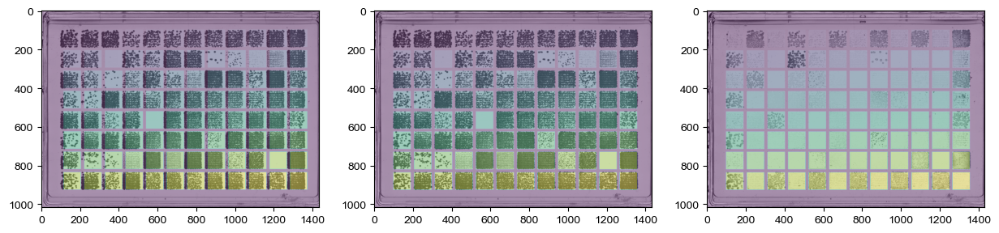

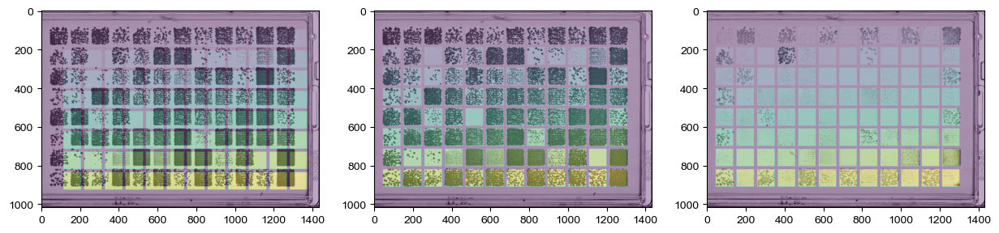

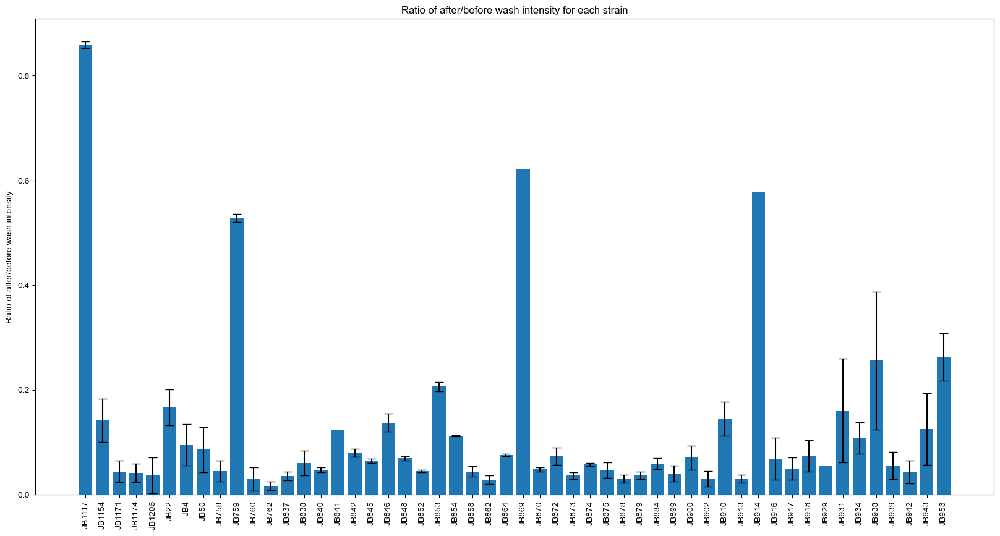

In [168]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM + H2O2_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM + H2O2_after"
wild_isolate_emm_H2O2 =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_emm_H2O2)

# Wild isolates YES hydrogen peroxide


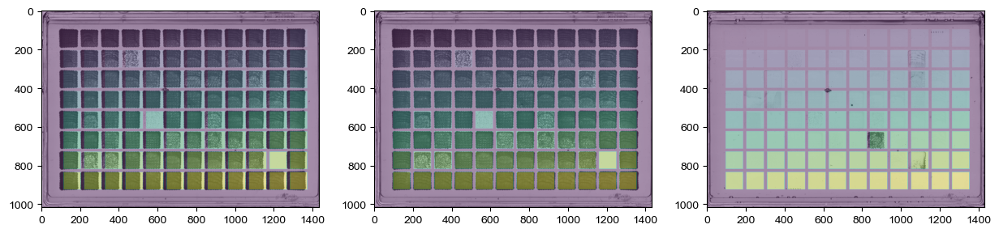

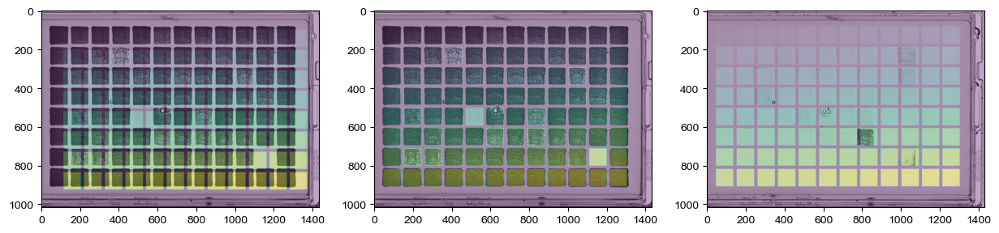

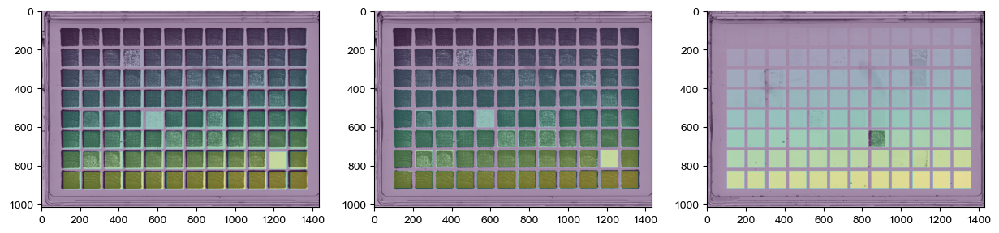

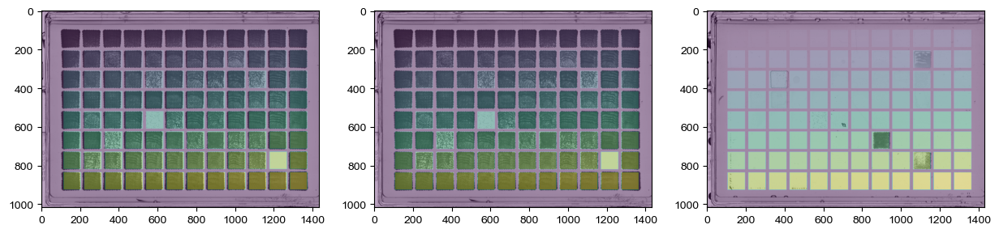

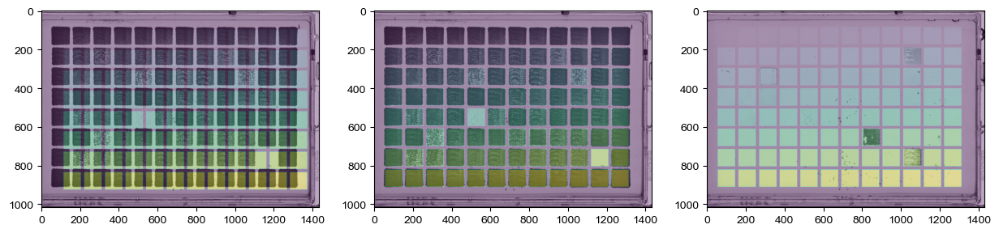

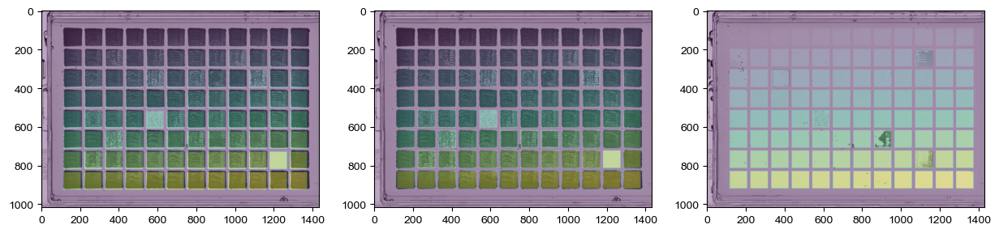

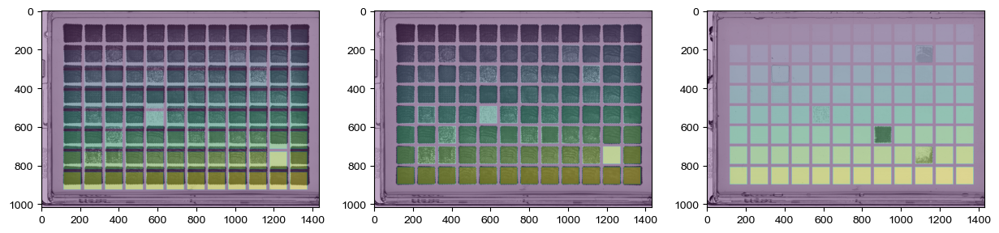

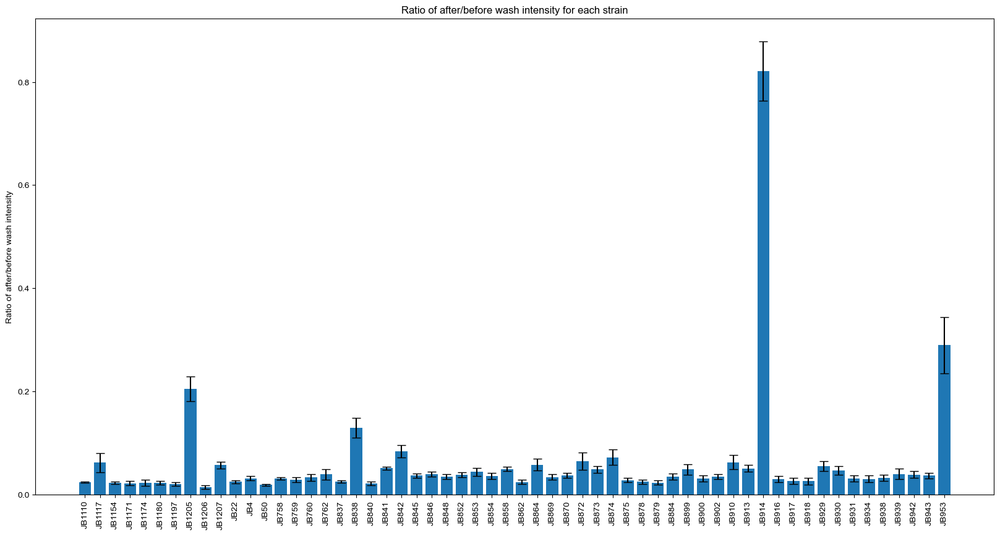

In [169]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_YES + H2O2_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_YES + H2O2_after"
wild_isolate_yes_H2O2 =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_yes_H2O2)

# N starvation in Wild isolates

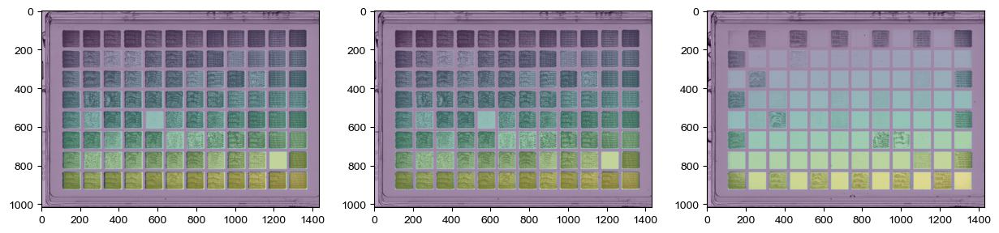

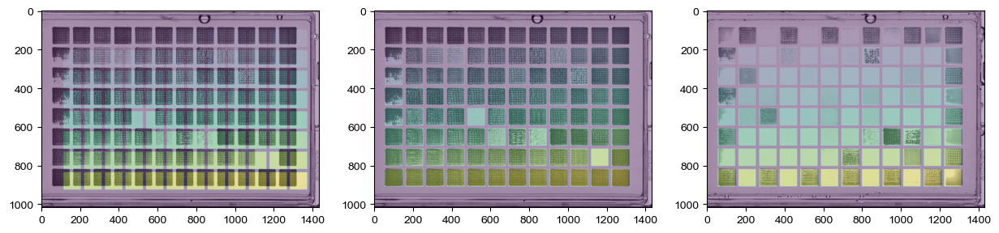

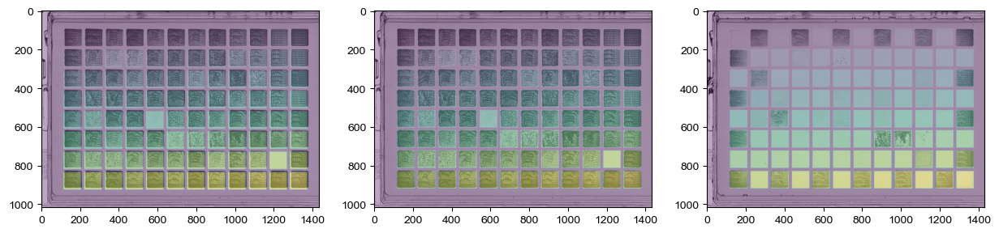

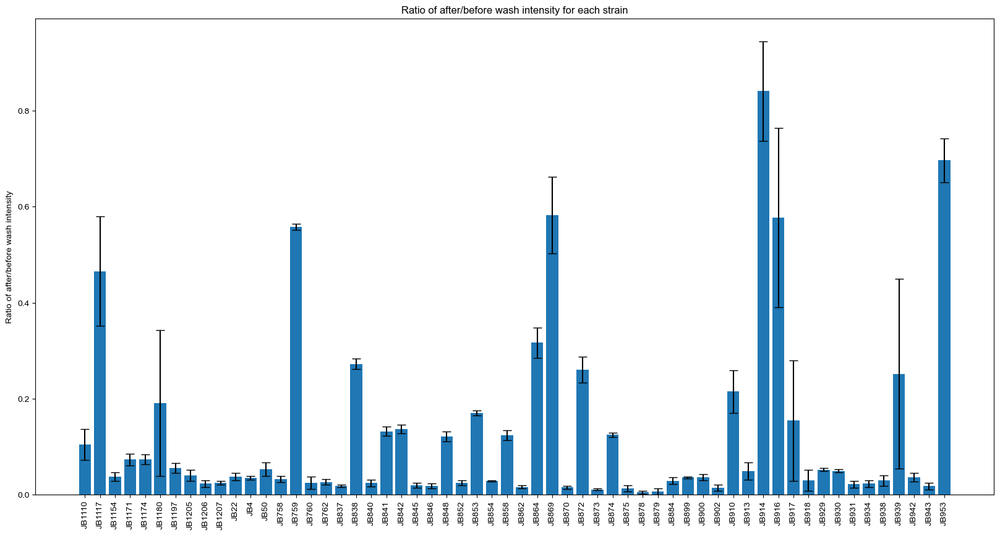

In [170]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Nitrogen_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Nitrogen_after"
wild_isolate_emm_n =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_emm_n)

# P starvation in Wild Isolates

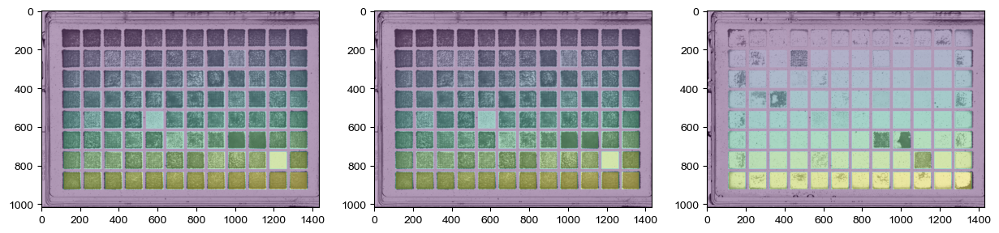

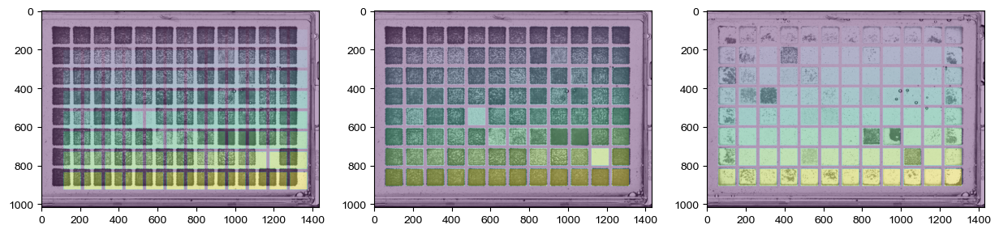

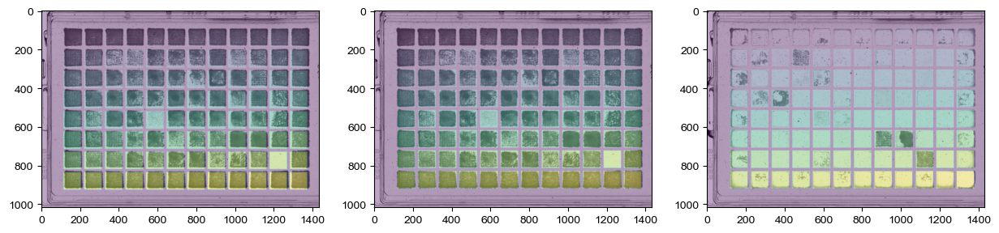

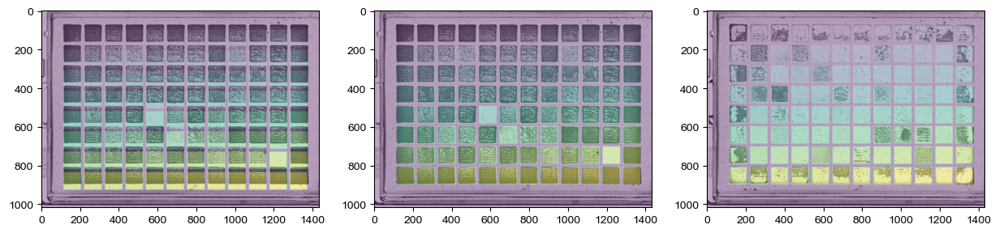

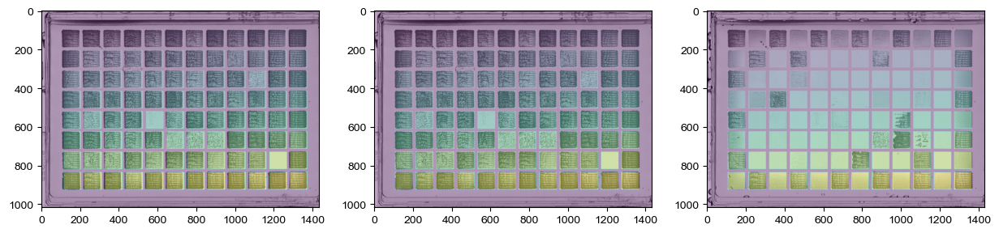

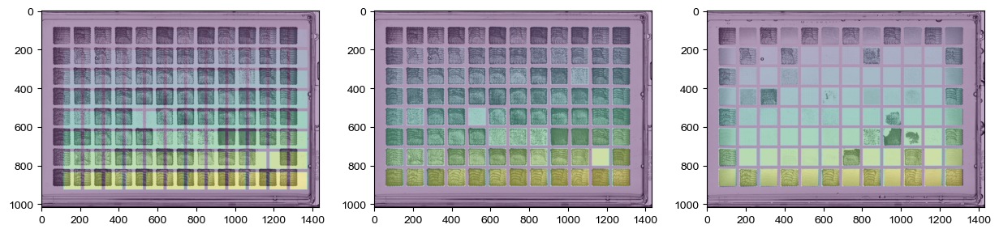

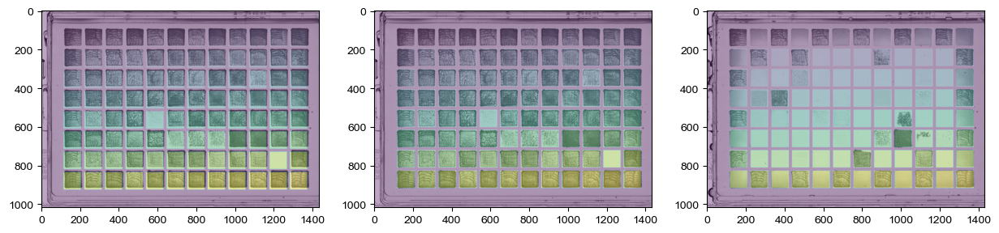

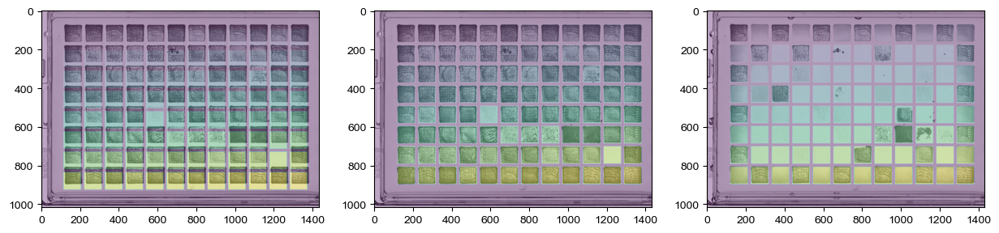

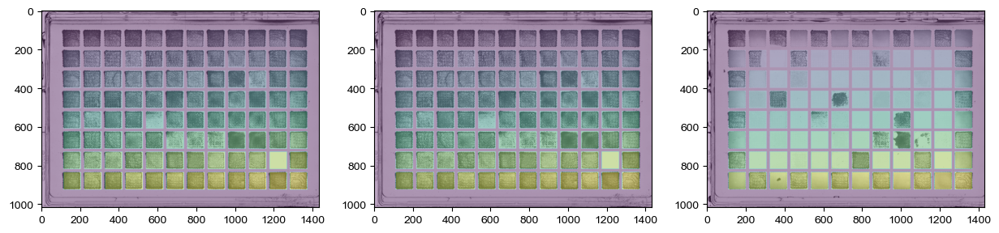

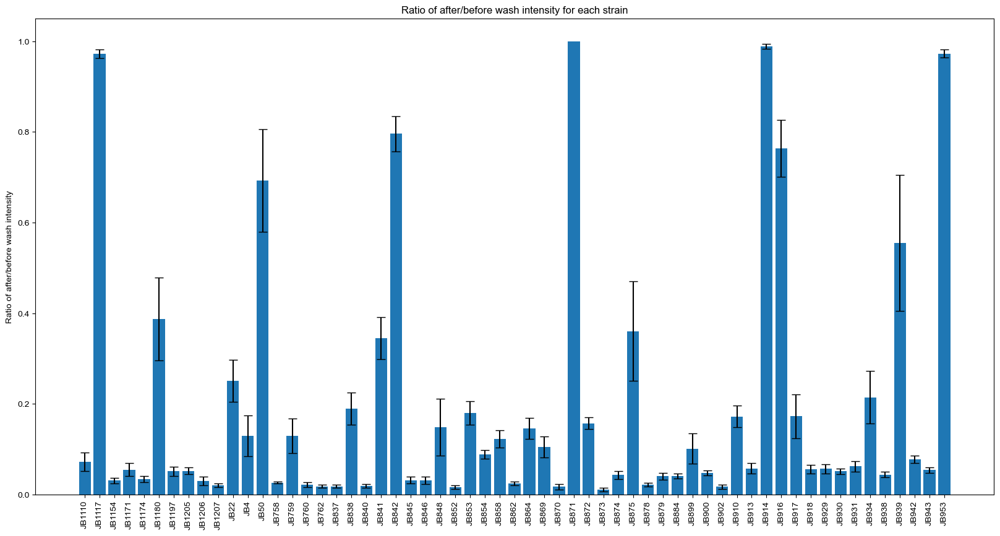

In [171]:
folder1 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Phosphate_before"
folder2 = root + "internal data/imaging_adhesion/Wild Isolates_EMM - Phosphate_after"
wild_isolate_emm_p =  adh.result_from_folders_of_ims(folder1,folder2,  new_wild_isolate_map, image_for_raw_layout)
adh.barchart_from_res(wild_isolate_emm_p)

### Segregants on EMM

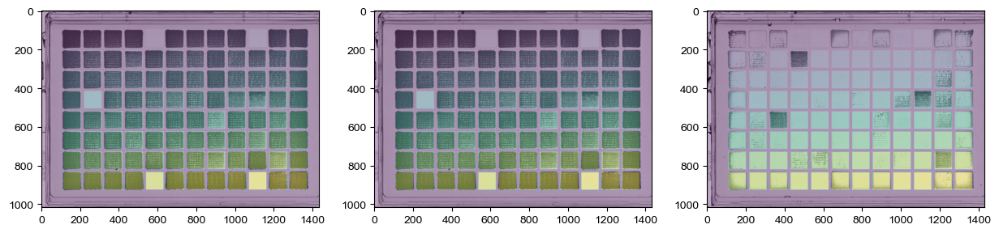

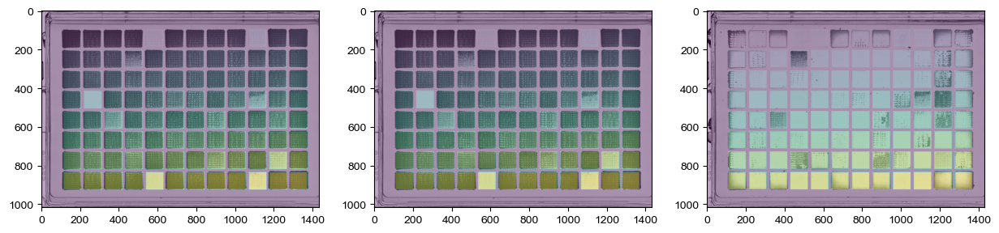

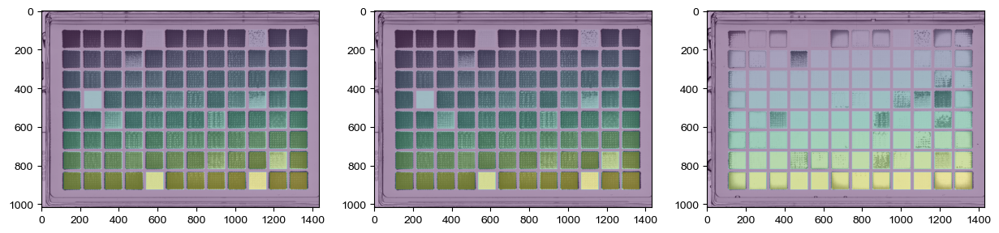

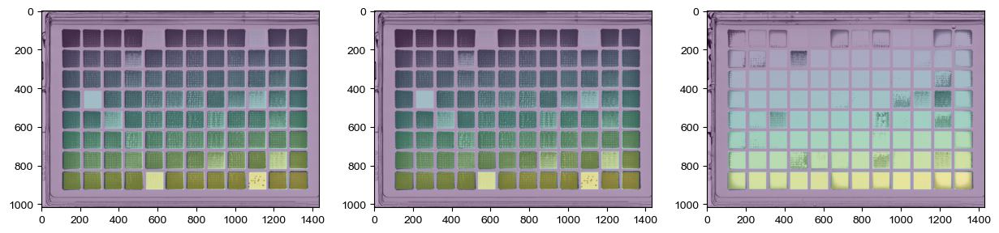

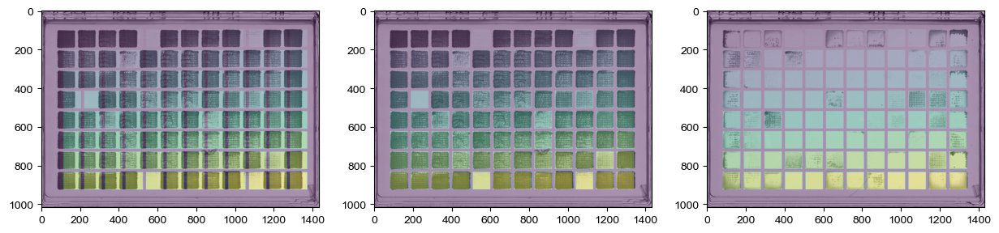

...

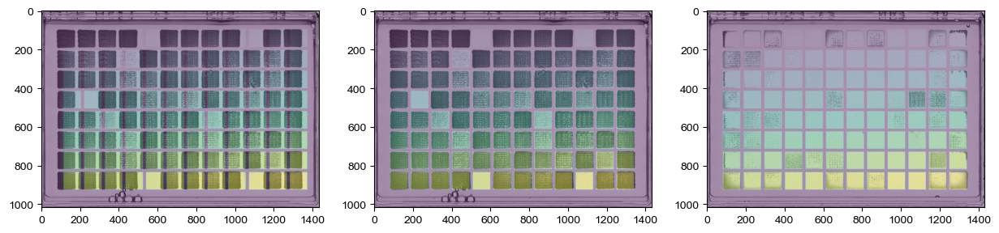

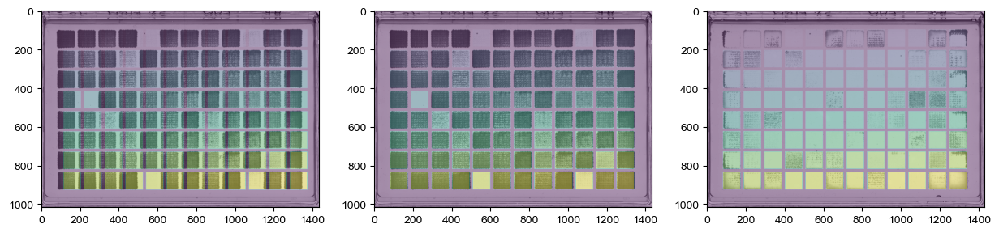

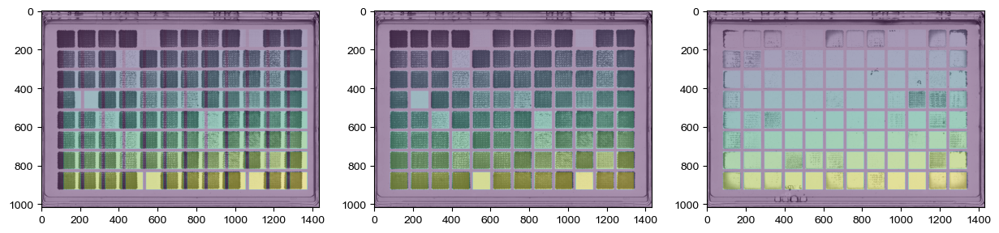

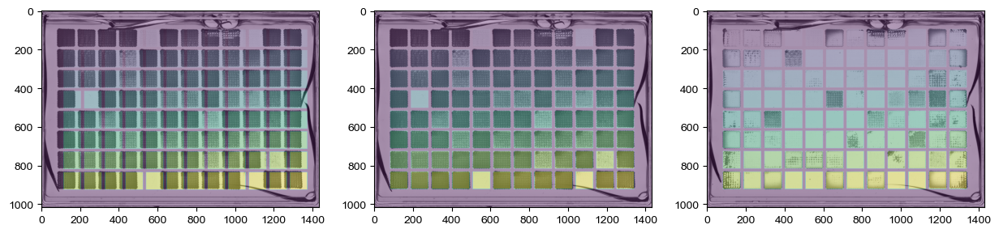

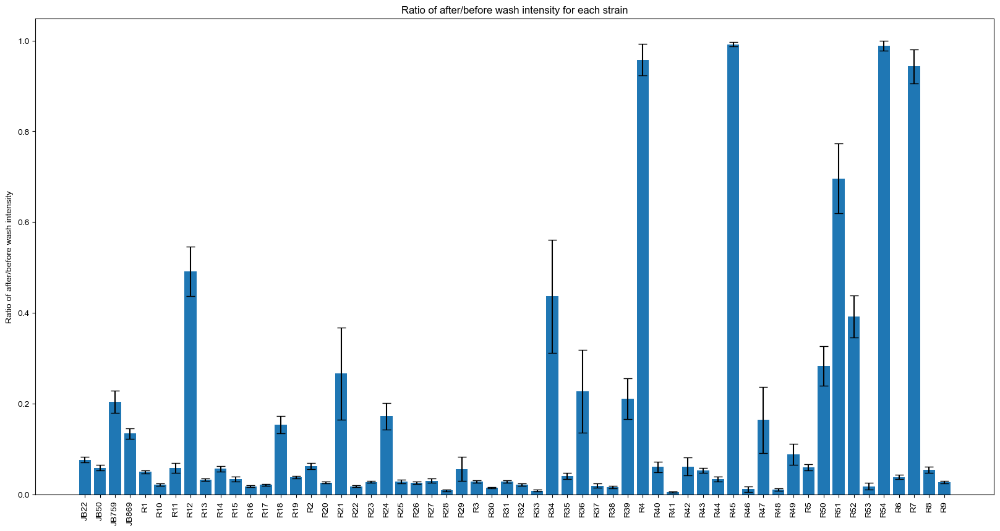

In [172]:
folder1 = root + "internal data/imaging_adhesion/Segregants_EMM_before"
folder2 = root + "internal data/imaging_adhesion/Segregants_EMM_after"
segregant_emm =  adh.result_from_folders_of_ims(folder1,folder2,  segregant_map , image_for_raw_layout)
segregant_emm.to_csv(root + "Bence folder/Image processing - Adhesion assay/segregants_emm.csv")
adh.barchart_from_res(segregant_emm)

### Segregants on YES


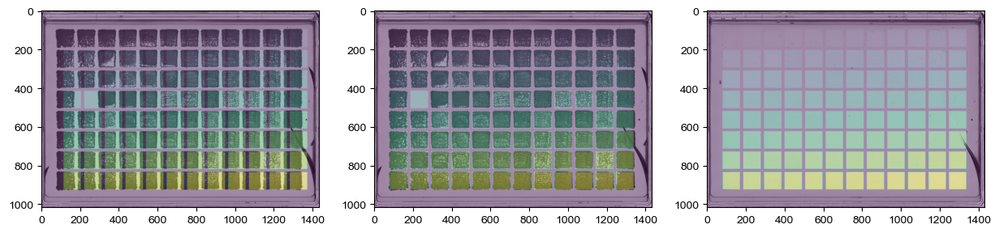

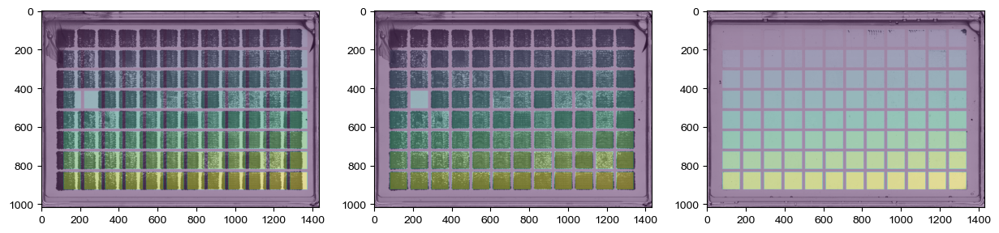

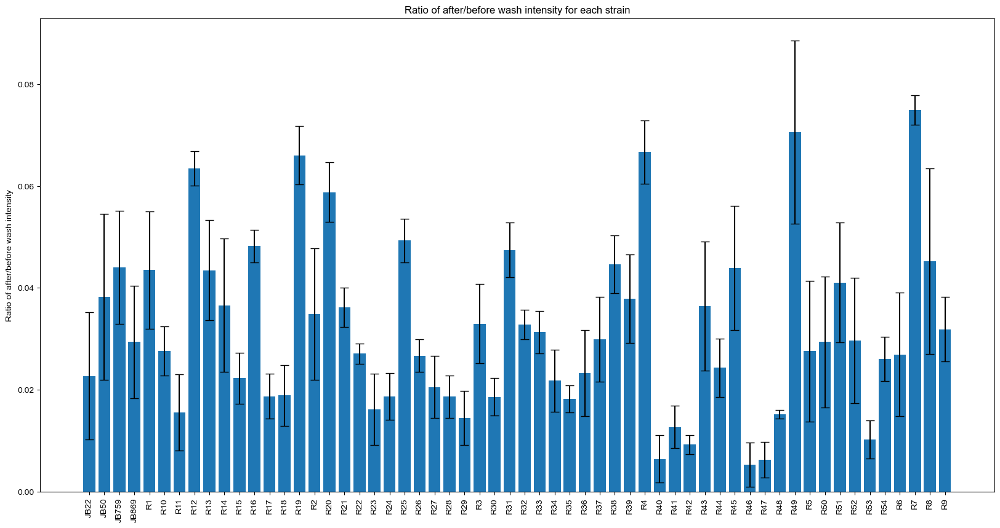

In [173]:
folder1 = root + "internal data/imaging_adhesion/Segregants_YES_before"
folder2 = root + "internal data/imaging_adhesion/Segregants_YES_after"
segregant_yes =  adh.result_from_folders_of_ims(folder1,folder2,  segregant_map , image_for_raw_layout)
adh.barchart_from_res(segregant_yes)


# Segregants on EMM-P

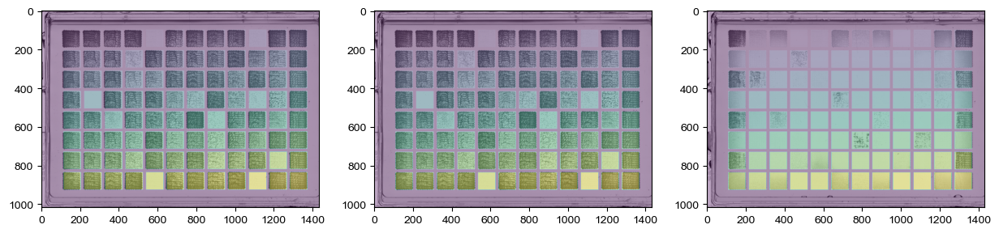

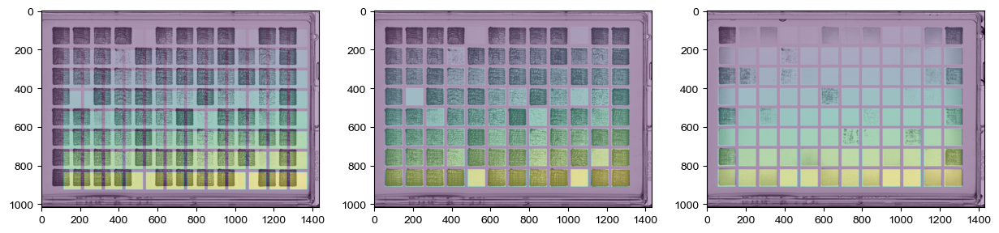

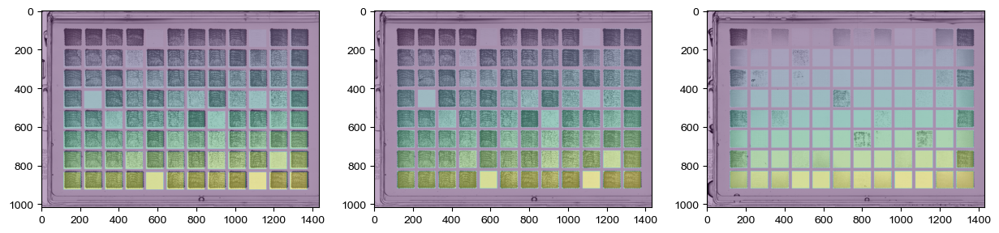

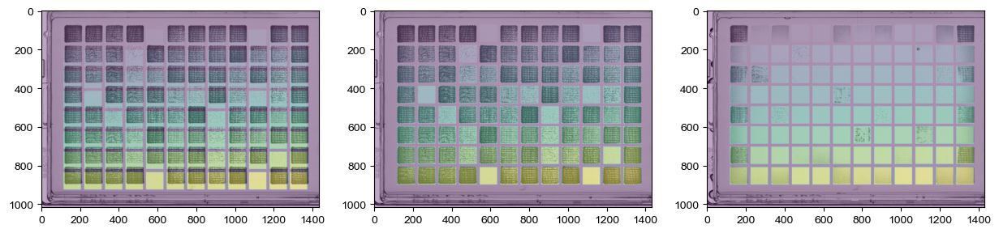

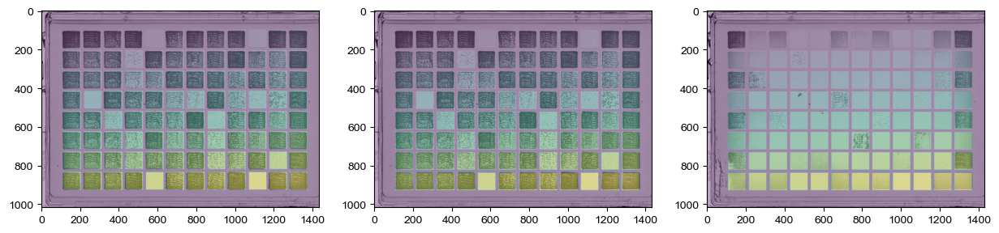

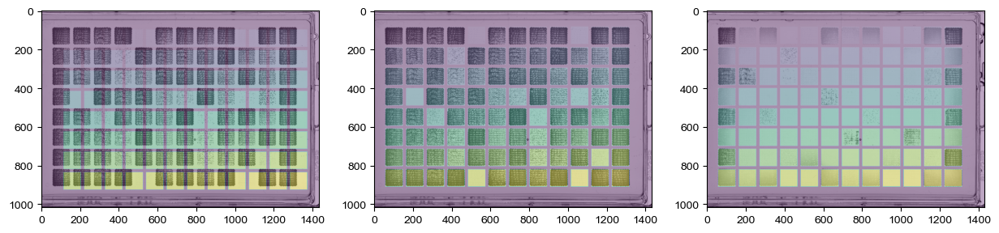

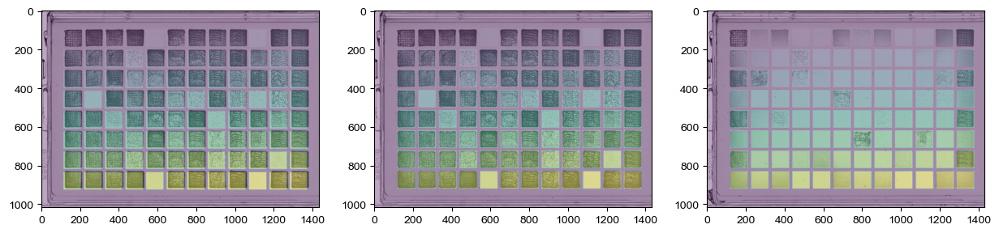

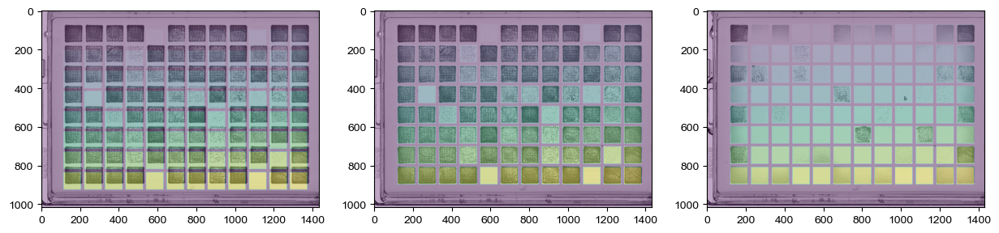

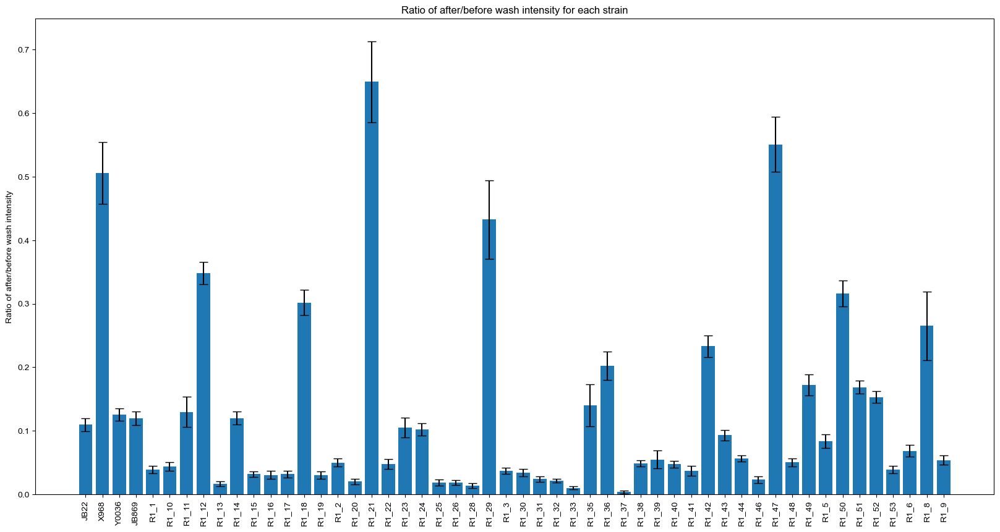

In [174]:
### Segregants on EMM - P
folder1 = root + "internal data/imaging_adhesion/Segregants_EMM - Phosphate_before"
folder2 = root + "internal data/imaging_adhesion/Segregants_EMM - Phosphate_after"
segregant_emm_p =  adh.result_from_folders_of_ims(folder1,folder2,  segregant_map , image_for_raw_layout)
#change JB50 to X968
segregant_emm_p.loc[segregant_emm_p['strain']=='JB50','strain'] = 'X968'
#change JB759 to Y0036
segregant_emm_p.loc[segregant_emm_p['strain']=='JB759','strain'] = 'Y0036'
#if strain name contains R, change R to R1_
segregant_emm_p.loc[segregant_emm_p['strain'].str.contains('R'),'strain'] = segregant_emm_p.loc[segregant_emm_p['strain'].str.contains('R'),'strain'].str.replace('R','R1_')
#remove R1_4, R1_7, R_45, R_54 because they liekly have nothing to do with phosphate
segregant_emm_p.to_csv(root + "Bence folder/Image processing - Adhesion assay/segregants_emm_p.csv")
adh.barchart_from_res(segregant_emm_p)

In [175]:
segregant_emm_p

,strain,ratio,before_wash,after_wash,sem,filtered_all_ratio_vals,n
0,JB22,0.109780,0.319282,0.035345,0.010228,"[0.07554387490820853, 0.13696004039584006, 0.0...",8
1,X968,0.505795,0.285724,0.144538,0.048902,"[0.41716394708749177, 0.6155303427974378, 0.25...",8
2,Y0036,0.125592,0.306748,0.038375,0.009516,"[0.09596625420102207, 0.07186926285295449, 0.0...",16
3,JB869,0.120057,0.315206,0.037864,0.010628,"[0.06550281052920204, 0.1118969398315639, 0.09...",8
4,R1_1,0.039253,0.325645,0.012881,0.006070,"[0.021865424930977654, 0.026332484855295248, 0...",8
5,R1_10,0.044029,0.325281,0.014506,0.006837,"[0.01900117932661743, 0.06061529102226897, 0.0...",8
6,R1_11,0.129901,0.162784,0.019882,0.023892,"[0.061327925440309884, 0.10871091726040681, 0....",7
7,R1_12,0.348168,0.138278,0.048388,0.017344,"[0.2524205671123189, 0.3434852791503773, 0.298...",8
8,R1_13,0.016337,0.411996,0.006821,0.003987,"[0.0068377800061980515, 0.003677545314838337, ...",8
9,R1_14,0.120222,0.200799,0.024171,0.010396,"[0.08193169754745838, 0.1421325426010845, 0.09...",8


# Plotting Segregant data on EMM vs EMM-P side by side 

[Text(0, 0, 'JB22'),
 Text(1, 0, 'JB50'),
 Text(2, 0, 'JB759'),
 Text(3, 0, 'JB869'),
 Text(4, 0, 'R1_1'),
 Text(5, 0, 'R1_10'),
 Text(6, 0, 'R1_11'),
 Text(7, 0, 'R1_12'),
 Text(8, 0, 'R1_13'),
 Text(9, 0, 'R1_14'),
 Text(10, 0, 'R1_15'),
 Text(11, 0, 'R1_16'),
 Text(12, 0, 'R1_17'),
 Text(13, 0, 'R1_18'),
 Text(14, 0, 'R1_19'),
 Text(15, 0, 'R1_2'),
 Text(16, 0, 'R1_20'),
 Text(17, 0, 'R1_21'),
 Text(18, 0, 'R1_22'),
 Text(19, 0, 'R1_23'),
 Text(20, 0, 'R1_24'),
 Text(21, 0, 'R1_25'),
 Text(22, 0, 'R1_26'),
 Text(23, 0, 'R1_27'),
 Text(24, 0, 'R1_28'),
 Text(25, 0, 'R1_29'),
 Text(26, 0, 'R1_3'),
 Text(27, 0, 'R1_30'),
 Text(28, 0, 'R1_31'),
 Text(29, 0, 'R1_32'),
 Text(30, 0, 'R1_33'),
 Text(31, 0, 'R1_34'),
 Text(32, 0, 'R1_35'),
 Text(33, 0, 'R1_36'),
 Text(34, 0, 'R1_37'),
 Text(35, 0, 'R1_38'),
 Text(36, 0, 'R1_39'),
 Text(37, 0, 'R1_4'),
 Text(38, 0, 'R1_40'),
 Text(39, 0, 'R1_41'),
 Text(40, 0, 'R1_42'),
 Text(41, 0, 'R1_43'),
 Text(42, 0, 'R1_44'),
 Text(43, 0, 'R1_45'),
 Tex

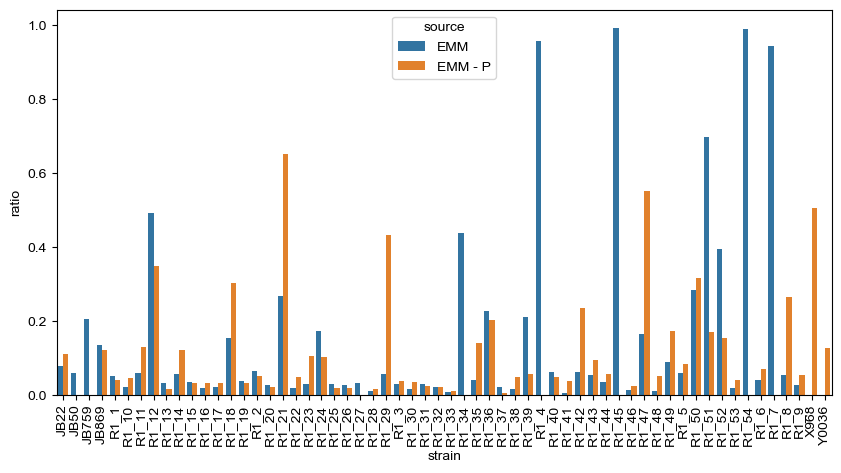

In [176]:
#merge segregant_emm_p with segregant_emm on strain
#in segregant_emm_pre_merge change R in strain names to R1_, if there is R at all
segregant_emm_pre_merge = segregant_emm.copy()
segregant_emm_pre_merge["source"] = "EMM"
segregant_emm_pre_merge["strain"] = segregant_emm_pre_merge["strain"].str.replace('R','R1_')
segregant_emm_p_pre_merge = segregant_emm_p.copy()
segregant_emm_p_pre_merge["source"] = "EMM - P"
merged_seg = pd.concat([segregant_emm_pre_merge,segregant_emm_p_pre_merge])
#barplot of ratio by strain colored by source
#large plot
fig,ax=plt.subplots(figsize=(10,5))
sns.barplot(x="strain", y="ratio", hue="source", data=merged_seg)
#ticks twisted
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

# Different versions of the WI library

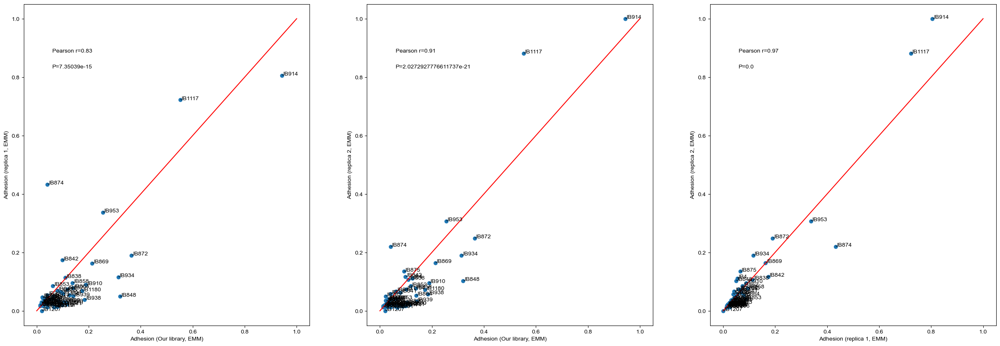

In [177]:
#merge phenotype gwas with mimi and cris and show bars grouped by strain
wi_emm_wi_mimi = pd.merge(wild_isolate_emm,wild_isolate_mimi_emm, on="strain")
wi_emm_wi_mimi_cris = pd.merge(wi_emm_wi_mimi,wild_isolate_cris_emm,on="strain")
wi_emm_wi_mimi_cris = wi_emm_wi_mimi_cris.rename(columns={"ratio_x":"ratio","ratio_y":"ratio_mimi","ratio":"ratio_cris"})



#make three separate scatter plots of the three ratios, overlay a 1:1 line
fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize=(30,10))
ax1.scatter(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_mimi"])
ax1.plot([0,1],[0,1],color="red")
ax1.set_xlabel("Adhesion (Our library, EMM)")
ax1.set_ylabel("Adhesion (replica 1, EMM)")
#print corr coef and p
ax1.text(0.1,0.85,"Pearson r="+str(round(wi_emm_wi_mimi_cris["ratio"].corr(wi_emm_wi_mimi_cris["ratio_mimi"],method="pearson"),2)),transform=ax1.transAxes)
ax1.text(0.1,0.8,"P="+str(round(stats.pearsonr(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_mimi"])[1],20)),transform=ax1.transAxes)
ax2.scatter(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_cris"])
ax2.plot([0,1],[0,1],color="red")
ax2.set_xlabel("Adhesion (Our library, EMM)")
ax2.set_ylabel("Adhesion (replica 2, EMM)")
#print corr coef and p
ax2.text(0.1,0.85,"Pearson r="+str(round(wi_emm_wi_mimi_cris["ratio"].corr(wi_emm_wi_mimi_cris["ratio_cris"],method="pearson"),2)),transform=ax2.transAxes)
ax2.text(0.1,0.8,"P="+str(round(stats.pearsonr(wi_emm_wi_mimi_cris["ratio"],wi_emm_wi_mimi_cris["ratio_cris"])[1],50)),transform=ax2.transAxes)

ax3.scatter(wi_emm_wi_mimi_cris["ratio_mimi"],wi_emm_wi_mimi_cris["ratio_cris"])
ax3.plot([0,1],[0,1],color="red")
ax3.set_xlabel("Adhesion (replica 1, EMM)")
ax3.set_ylabel("Adhesion (replica 2, EMM)")
#print corr coef and p
ax3.text(0.1,0.85,"Pearson r="+str(round(wi_emm_wi_mimi_cris["ratio_mimi"].corr(wi_emm_wi_mimi_cris["ratio_cris"],method="pearson"),2)),transform=ax3.transAxes)
ax3.text(0.1,0.8,"P="+str(round(stats.pearsonr(wi_emm_wi_mimi_cris["ratio_mimi"],wi_emm_wi_mimi_cris["ratio_cris"])[1],20)),transform=ax3.transAxes)
#add strain name to each dot
for i, txt in enumerate(wi_emm_wi_mimi_cris["strain"]):
      ax1.annotate(txt, (wi_emm_wi_mimi_cris["ratio"][i], wi_emm_wi_mimi_cris["ratio_mimi"][i]))
      ax2.annotate(txt, (wi_emm_wi_mimi_cris["ratio"][i], wi_emm_wi_mimi_cris["ratio_cris"][i]))
      ax3.annotate(txt, (wi_emm_wi_mimi_cris["ratio_mimi"][i], wi_emm_wi_mimi_cris["ratio_cris"][i]))

plt.savefig(root + "Figures/All figures/Compare isolate libraries supplementary.svg", format="svg", dpi=400)
#as png
plt.savefig(root + "Figures/All figures/Compare isolate libraries supplementary.png", format="png", dpi=400)


# Plot of all the conditions



In [204]:
#concat phenotype_caf phenotype_caf_rap phenotype_caf_rap phenotype_gwas phenotype_yes phenotype_h2o2_yes phenotype_edta_yes into condition_plot_df
condition_plot_df = pd.concat([wild_isolate_yes,wild_isolate_yes_caf,wild_isolate_yes_caf_rap,wild_isolate_yes_rap,wild_isolate_yes_H2O2,wild_isolate_emm,wild_isolate_emm_p,wild_isolate_emm_n])
condition_plot_df = condition_plot_df.reset_index(drop=True)

conditions = np.array([["YES\n n=8"] * len(wild_isolate_yes)])[0]



conditions = np.append(conditions, [["YES Caffeine\n (10mM) \n n=10"] * len(wild_isolate_yes_caf)])
conditions = np.append(conditions, [["YES Caffeine\n + Rapamycin\n n=5"] * len(wild_isolate_yes_caf_rap)])
conditions = np.append(conditions, [["YES Rapamycin\n (100 ng/ml)\n n=2"] * len(wild_isolate_yes_rap)])
conditions = np.append(conditions, [["YES H2O2\n n=7"] * len(wild_isolate_yes_H2O2)])
conditions = np.append(conditions, [["EMM\n n=11"] * len(wild_isolate_emm)])
conditions = np.append(conditions, [["EMM-P\n n=9"] * len(wild_isolate_emm_p)])
conditions = np.append(conditions, [["EMM-N\n n=3"] * len(wild_isolate_emm_n)])
condition_plot_df["condition"] = conditions
#remove strain EMPTY
condition_plot_df = condition_plot_df[condition_plot_df["strain"]!="EMPTY"]
#RESET
condition_plot_df = condition_plot_df.reset_index(drop=True)
#reorder as YES, EMM, Caffeine, Caffeine + Rapamycin, Rapamycin, YES H2O2, YES EDTA
#strains above 0.3 in at least one conditoon
highest_strains = np.unique(condition_plot_df[condition_plot_df["ratio"]>0.2]["strain"])
all_strains = np.unique(condition_plot_df["strain"])



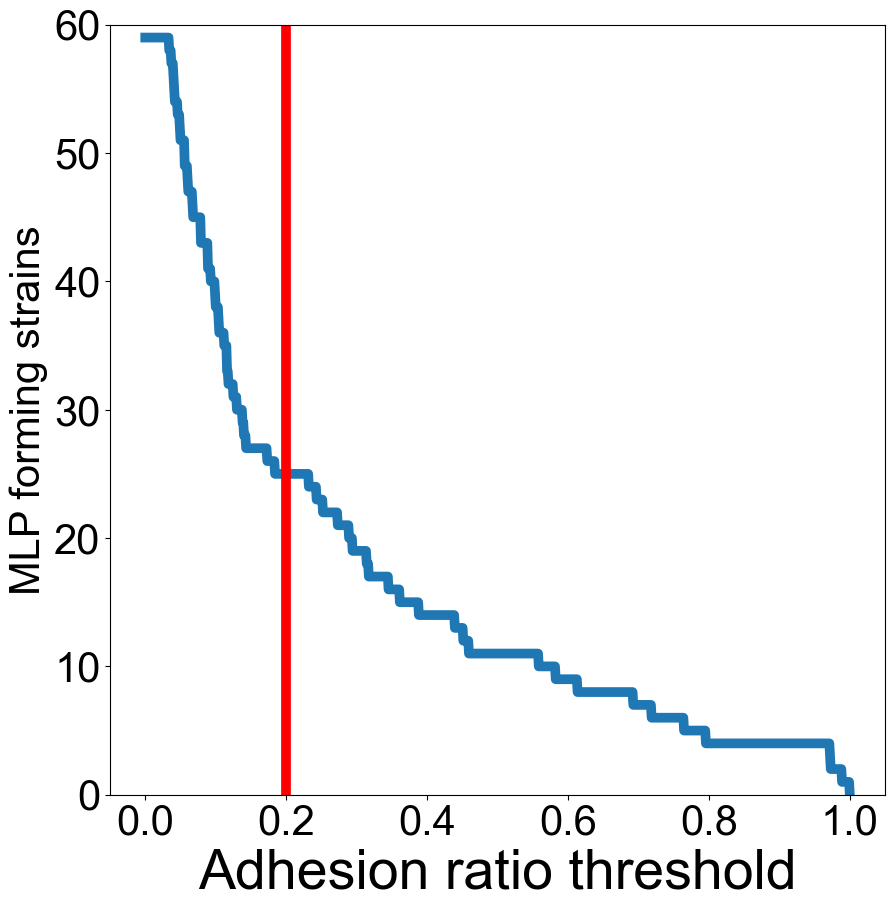

In [205]:
x = np.linspace(0, 1, 1000)

unique_highest_strains = []
for i in x:
    unique_highest_strains.append(len(np.unique(condition_plot_df[condition_plot_df["ratio"]>i]["strain"])))
fig, ax = plt.subplots(figsize=(10, 10))
ax.plot(x,unique_highest_strains,lw=7)
#draw red line at 0.2
ax.plot([0.2,0.2],[0,60],color="red",lw=7)
ax.set_xlabel("Adhesion ratio threshold",fontsize=40)
ax.set_ylabel("MLP forming strains",fontsize=30)
ax.tick_params(axis='both', which='major', labelsize=30)
ax.set_ylim(0,60)
plt.savefig(root + "Figures/All figures/Elbow plot for MLP strains.svg", format="svg", dpi=400)
#as png
plt.savefig(root + "Figures/All figures/Elbow plot for MLP strains.png", format="png", dpi=400)


In [206]:
print(len(highest_strains))
print("The fraction of cells sticking in at least one condition is "+str(len(highest_strains)/len(all_strains)))

25
The fraction of cells sticking in at least one condition is 0.423728813559322


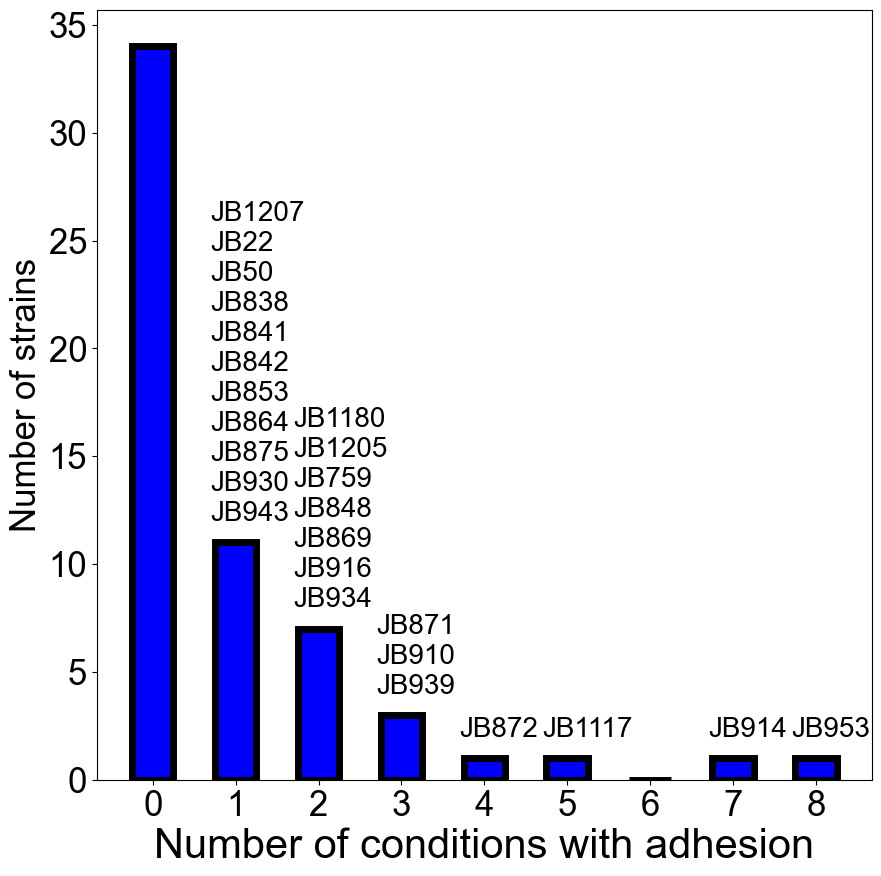

In [207]:
#make histogram of how many conditions each strain is above 0.2
n_of_conds = []
for strain in all_strains:
    n_of_conds.append(len(condition_plot_df[condition_plot_df["strain"]==strain][condition_plot_df["ratio"]>0.2]))
fig, ax = plt.subplots(figsize=(10, 10))
ax.hist(n_of_conds,bins=range(0,10),align="left",rwidth=0.5,color="blue",edgecolor="black",linewidth=5)
#above each bin, except 0, write the names of the strains
for i in range(1,9):
    #find which strains are in this bin
    n_of_conds_index = np.where(np.array(n_of_conds)==i)[0]
    #get the names of these strains
    n_of_conds_strains = np.array(all_strains)[n_of_conds_index]
    #write the names of these strains above the bin, also calculate height of bin
    height_of_given_bin = len(n_of_conds_index==i)
    ax.text(i-0.3,height_of_given_bin+1,"\n".join(n_of_conds_strains),fontsize=20)

ax.set_xlabel("Number of conditions with adhesion",fontsize=30)
ax.set_ylabel("Number of strains",fontsize=25)
ax.set_xticks(range(0,9))
ax.tick_params(axis='both', which='major', labelsize=25)

plt.savefig(root + "Figures/All figures/Number of conditions with adhesion.svg", format="svg", dpi=400)
#as png
plt.savefig(root + "Figures/All figures/Number of conditions with adhesion.png", format="png", dpi=400)
    
    

YES
 n=8 YES Caffeine
 (10mM) 
 n=10 -0.6910961131917136 1.7535
YES
 n=8 YES Caffeine
 + Rapamycin
 n=5 -1.029561947480974 1.1360999999999999
YES
 n=8 YES Rapamycin
 (100 ng/ml)
 n=2 0.21687108859281334 4.0873
YES
 n=8 YES H2O2
 n=7 0.9522148689829122 5.7659
YES
 n=8 EMM
 n=11 -1.3532753672591742 0.6678
YES
 n=8 EMM-P
 n=9 -2.44926946478418 0.048299999999999996
YES
 n=8 EMM-N
 n=3 -1.217731532122955 0.777


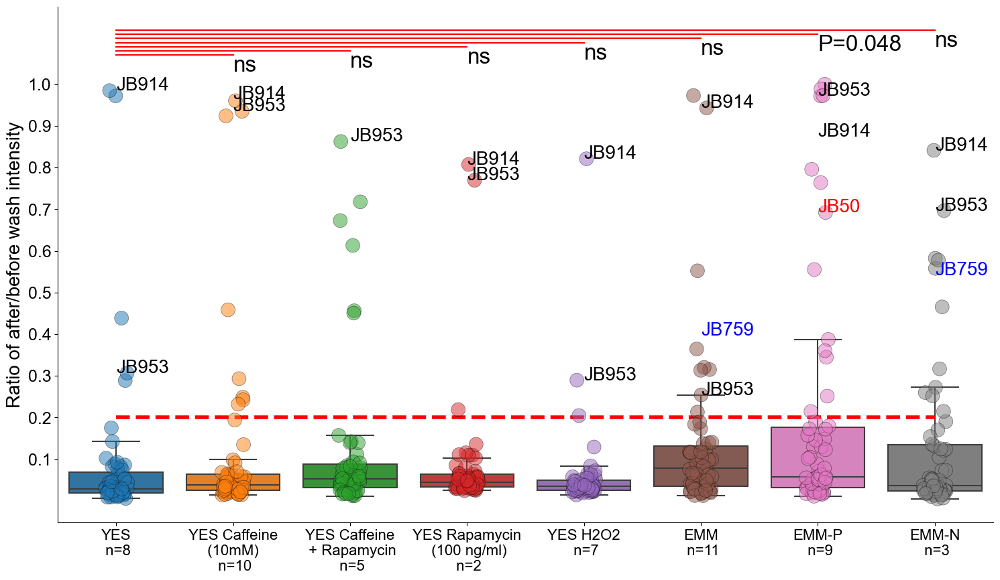

In [208]:
#Make sns boxplot and overlaid stripplot of condition_plot_df with x=condition and y=ratio
conditions=[     "YES\n n=8",
      "YES Caffeine\n (10mM) \n n=10",
      "YES Caffeine\n + Rapamycin\n n=5",
      "YES Rapamycin\n (100 ng/ml)\n n=2",
      "YES H2O2\n n=7",
      "EMM\n n=11",
      "EMM-P\n n=9",
      "EMM-N\n n=3"]

interesting_strains = ["JB50","JB759", "JB914", "JB953"]

plt.figure(figsize=(18,10),facecolor="None")
sns.boxplot(x="condition",y="ratio",data=condition_plot_df,showfliers=False)
#put black outline for circles
sns.stripplot(x="condition",y="ratio",data=condition_plot_df,jitter=True,size=15,linewidth=0.5,edgecolor="black",alpha=0.5)
plt.ylabel("Ratio of after/before wash intensity")
#draw bars between YES and all other conditions
for i in range(1,len(conditions)):
      #choose strain and ratio
      p1 = condition_plot_df[condition_plot_df["condition"]==conditions[0]]["ratio"].values
      p2 = condition_plot_df[condition_plot_df["condition"]==conditions[i]]["ratio"].values
     
      #mann whitney u test
      s,p = stats.ttest_ind(p1,p2,permutations=10000,alternative="less")
      p=p*(len(conditions)-1)
                            
      
      
      print(conditions[0],conditions[i],s,p)
      
      plt.plot([0,i],[i*0.01+1.06,i*0.01+1.06],color="red")
      if p<0.05:
            plt.text(i,i*0.01+1.02,"P="+str(round(p,3)),fontsize=24)
      if p>0.05:
            plt.text(i,i*0.01+1.02,"ns",fontsize=24)
      
#to condition_plot_df add two columns, x_vals and y_vals, which correspond to conditions.index(condition_plot_df["condition"][i]) and ratio

condition_plot_df['x_vals'] = condition_plot_df["condition"].apply(lambda x: conditions.index(x))
condition_plot_df['y_vals'] = condition_plot_df["ratio"]


#for y_vals in the same condition and above 0.2, make sure they are all at least 0.05 apart
for i in range(len(condition_plot_df)):
      #if above 0.2
      if condition_plot_df["ratio"][i]>0.2:
            #find whether there is another one close to it
            n_neighbors = len(condition_plot_df[condition_plot_df["x_vals"]==condition_plot_df["x_vals"][i]][abs(condition_plot_df["y_vals"]-condition_plot_df["y_vals"][i])<0.03])
            while n_neighbors>1:
                  #change y_val with a normal distribution 0.05 wide
                  condition_plot_df["y_vals"][i] = condition_plot_df["y_vals"][i] + np.random.normal(0,0.005)
                  #y_val cannot be larger than 1 or smaller than 0.2
                  if condition_plot_df["y_vals"][i]>1:
                        condition_plot_df["y_vals"][i] = 1
                  if condition_plot_df["y_vals"][i]<0.2:
                        condition_plot_df["y_vals"][i] = 0.2
                  n_neighbors = len(condition_plot_df[condition_plot_df["x_vals"]==condition_plot_df["x_vals"][i]][abs(condition_plot_df["y_vals"]-condition_plot_df["y_vals"][i])<0.03])

for i in range(len(condition_plot_df)):
      if condition_plot_df["strain"][i] in interesting_strains and condition_plot_df["ratio"][i]>0.2:
            #if there is same x val and y_val that is within 0.05, then add y_jitter, such that the text is not on top of each other
            #find index where x_vals==condition and y_vals are within 0.05 of condition_plot_df["ratio"][i]
            color = "black"
            if condition_plot_df["strain"][i]=="JB50":
                  color = "red"
            elif condition_plot_df["strain"][i]=="JB759":
                  color = "blue"
            plt.text(condition_plot_df["x_vals"][i],condition_plot_df["y_vals"][i],condition_plot_df["strain"][i],fontsize=20,color=color)
            

#draw a linea t 0.3
plt.plot([0,7],[0.2,0.2],color="red",linestyle="--",lw=4)
#larger ticks and labels
plt.xticks(fontsize=16)
plt.yticks(fontsize=18)
plt.xlabel("",fontsize=20)
plt.ylabel("Ratio of after/before wash intensity",fontsize=20)
#onyl label y axis 0.2, 0.4, 0.6, 0.8, 1.0
plt.yticks([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0])
#remove background patch
sns.despine()


plt.savefig(root + "Figures/All figures/Compare isolates across conditions.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Compare isolates across conditions.png", format="png", dpi=400)


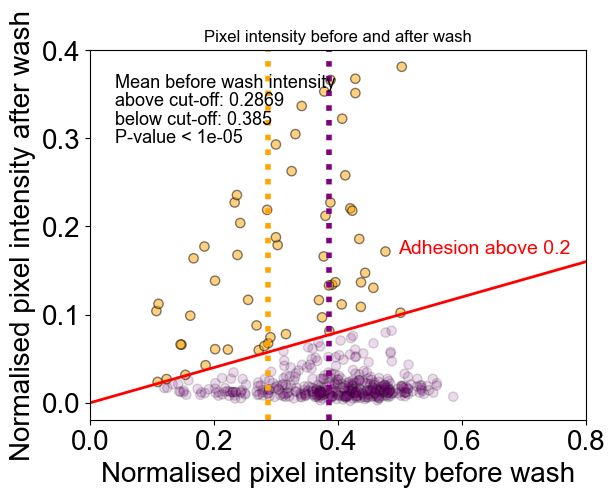

In [184]:
plot_bef_aft = condition_plot_df.copy()
plot_bef_aft["color"]="purple"
plot_bef_aft.loc[plot_bef_aft["after_wash"]>plot_bef_aft["before_wash"]*0.2,"color"]="orange"
#and alpha is normally 0.15, but 0.5 if ratio is above 95th percentile
plot_bef_aft["alpha"]=0.5
#if purple make alpha 0.5
plot_bef_aft.loc[plot_bef_aft["color"]=="purple","alpha"]=0.15
#also draw a line with slope of the ratio of the 95th percentile of ratio valiues
fig, ax = plt.subplots()
#if above the line color purple, otherwise yellow. add legend
ax.scatter(plot_bef_aft["before_wash"],plot_bef_aft["after_wash"], s=45, alpha=plot_bef_aft["alpha"], color=plot_bef_aft["color"], edgecolors="black")


ax.plot([0,1],[0,0.2], color="red", linewidth=2)
ax.set_xlabel("Normalised pixel intensity before wash", fontsize=20)
ax.set_ylabel("Normalised pixel intensity after wash", fontsize=20)
ax.set_title("Pixel intensity before and after wash")
#print p value of t test of values above and below. that means values above 95th percentile of ratio
above_vals=plot_bef_aft[plot_bef_aft["ratio"]>plot_bef_aft["ratio"].quantile(0.95)]["before_wash"]
below_vals=plot_bef_aft[plot_bef_aft["ratio"]<plot_bef_aft["ratio"].quantile(0.95)]["before_wash"]
#print mean before vals and p value
plt.text(0.05,0.9,"Mean before wash intensity",transform=ax.transAxes, fontsize=13)
plt.text(0.05,0.85,"above cut-off: "+str(round(above_vals.mean(),4)), transform=ax.transAxes, fontsize=13)
plt.text(0.05,0.8,"below cut-off: "+str(round(below_vals.mean(),4)), transform=ax.transAxes, fontsize=13)
plt.text(0.62,0.45,"Adhesion above 0.2", transform=ax.transAxes, color="red",fontsize=14)

#two vertical lines for before and after mean
ax.axvline([above_vals.mean()], color="orange", linestyle="dotted",lw=4)
ax.axvline([below_vals.mean()], color="purple", linestyle="dotted",lw=4)
#xlim 0 0.8
ax.set_xlim(0,0.8)
#larger ticks
ax.tick_params(axis='both', which='major', labelsize=20)
permutations=100000
p_val = stats.ttest_ind(above_vals, below_vals, equal_var=False, permutations=permutations).pvalue
#find how many digits after the decimal point
digits = -int(np.floor(np.log10(p_val+0.0000001)))+5
#round to that many digits

if p_val > 1/p_val:
    p_val = round(p_val, digits)
    plt.text(0.05,0.75,"P-value: "+str(p_val), transform=ax.transAxes, fontsize=13)
else:
    plt.text(0.05,0.75,"P-value < {}".format(1/permutations), transform=ax.transAxes, fontsize=13)


#
plt.savefig(root + "Figures/All figures/Isolates before after scatter.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Isolates before after scatter.png", format="png", dpi=400)

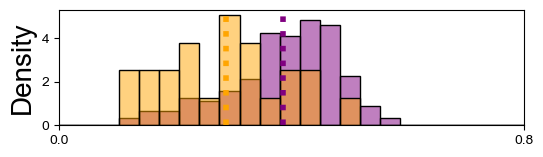

In [185]:

#bin number chosen by freedman diaconis rule
iqr = plot_bef_aft["before_wash"].quantile(0.75) - plot_bef_aft["before_wash"].quantile(0.25)
n_bins = int(1 / (2 * iqr * len(plot_bef_aft["before_wash"]) ** (-1 / 3)))
bins=np.linspace(0,1,n_bins)

fig, ax = plt.subplots(figsize=(6,1.5))
sns.histplot(data=plot_bef_aft[plot_bef_aft["ratio"] < plot_bef_aft["ratio"].quantile(0.95)], x="before_wash", bins=bins, color="purple", alpha=0.5, label="below 95th percentile", ax=ax, kde=False, stat="density")

sns.histplot(data=plot_bef_aft[plot_bef_aft["ratio"] > plot_bef_aft["ratio"].quantile(0.95)], x="before_wash", bins=bins, color="orange", alpha=0.5, label="above 95th percentile", ax=ax, kde=False, stat="density")

#remove x axis ticks
#ticks only 0 and 1
ax.set_xticks([0,0.8])
ax.set_xlabel("")
ax.set_ylabel("Density", fontsize=20)
#xlim 0 0.8
ax.set_xlim(0,0.8)

#two vertical lines for before and after mean
ax.axvline([above_vals.mean()], color="orange", linestyle="dotted",lw=4)
ax.axvline([below_vals.mean()], color="purple", linestyle="dotted",lw=4)
#set all text in the whole ntoebook to be arial
plt.savefig(root + "Figures/All figures/Isolates before after hist.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Isolates before after hist.png", format="png", dpi=400)

<Figure size 3000x1000 with 0 Axes>

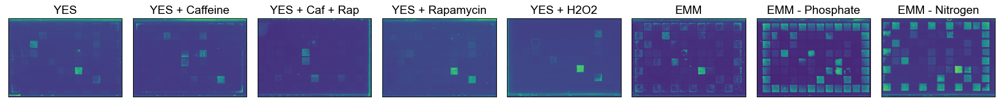

In [186]:
#write a function that takes in the names of folders which contain images of after images, and takes image x from that folder
#and shows it in viridis.

def representative_image(after_folder,ind_image,ax):
    """This function takes in the name of a folder which contains images of after wash images,
     and takes the 'ind_image'th image from that folder.
        It then shows the image in viridis colormap.

    after_folder: name of folder which contains images of after wash images
    ind_image: index of image to show
    """


    #get all images in the folder
    images = os.listdir(after_folder)
        #get the image name of the ind_image'th image
    image_name = images[ind_image]
    #read the image
    image = plt.imread(after_folder + "/" + image_name)
    #show the image in viridis colormap
    #invert the pixel intensity
    image = np.invert(image)
    background = np.percentile(image, 10)
    
    image=image-background
    #rescale by max value
    image=image/np.max(image)
    #crop 40 pixels from each side
    image = image[40:-40,40:-40]


    ax.imshow(image,cmap="viridis")
    

    


plt.figure(figsize=(30,10))

conds = ["YES", "YES + Caffeine", "YES + Caffeine + Rapamycin", "YES + Rapamycin", "YES + H2O2", "EMM",  "EMM - Phosphate","EMM - Nitrogen"]
# create a grid of subplots
fig, axs = plt.subplots(1, 8, figsize=(18, 5))

# loop over the conditions and plot the representative image for each condition
for i, ax in enumerate(axs):
    # get the folder name of the after wash images
    after_folder = root + "Internal data/imaging_adhesion/Wild Isolates_" + conds[i] + "_after/"
    # show the 0th image in that folder
    representative_image(after_folder, 1,ax)
    # set the title as the condition
    #if "YES + Caffeine + Rapamycin", then change to "YES + Caf + Rap"
    ax.set_title(conds[i], fontsize=15)
    if conds[i] == "YES + Caffeine + Rapamycin":
        ax.set_title("YES + Caf + Rap", fontsize=15)
    # remove the ticks
    ax.set_xticks([])
    ax.set_yticks([])
#tight layout
plt.tight_layout()
#save the figure
plt.savefig(root + "Figures/All figures/Representative images.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Representative images.png", format="png", dpi=400)

    

# Plotting segregant data

In [187]:
filtering = pd.read_csv(root + "internal data/Filtering assay/filtering_phenotypes.csv")
#in filtering rename X968 to JB50 and Y0036 to JB759
filtering["Strain"][filtering["Strain"]=="X968"] = "JB50"
filtering["Strain"][filtering["Strain"]=="Y0036"] = "JB759"
#Instead of naming strains R1_xx, name R + filtering["Strain"].str.split("1_").str[1] for only strains that start with R
for i in range(len(filtering)):
      if filtering["Strain"][i][0]=="R":
            filtering["Strain"][i] = "R" + filtering["Strain"][i].split("1_")[1]
        

filtering_grouped=filtering.groupby("Strain",as_index=False).mean()
filtering_grouped["sem"]=filtering.groupby("Strain",as_index=False).sem()["%flocc"]

#merge with phenotype_s strain and Strain in filtering_grouped
filtering_phenotype=filtering_grouped.merge(segregant_emm,left_on="Strain",right_on="strain",how="inner")
filtering_phenotype.head()

,Strain,Unnamed: 0,%flocc,sem_x,strain,ratio,before_wash,after_wash,sem_y,filtered_all_ratio_vals,n
0,JB50,0.0,0.081319,NaN,JB50,0.058741,0.449013,0.026218,0.006494,"[0.07141149524809001, 0.0380942380636818, 0.02...",10
1,JB759,1.0,0.449411,NaN,JB759,0.204073,0.427897,0.082697,0.024256,"[0.25638049945273517, 0.14965851154233306, 0.1...",20
2,R1,2.0,0.104369,NaN,R1,0.049828,0.474411,0.023633,0.003538,"[0.06257769811931344, 0.04742088120091089, 0.0...",10
3,R10,3.0,0.053252,NaN,R10,0.021806,0.472715,0.010219,0.002407,"[0.03331306947460987, 0.01946389427448803, 0.0...",10
4,R11,4.0,0.063310,NaN,R11,0.058402,0.268854,0.013206,0.010990,"[0.039473802937663095, 0.044758187263396844, 0...",10


In [188]:

filtering = pd.read_csv(root + "internal data/Filtering assay/filtering_results.csv", sep="\t")
#take median of each strain across Reps but also save sem in a new column
#divide %flocc by 100
filtering["%flocc"]=filtering["%flocc"]/100
filtering_grouped=filtering.groupby("Strain",as_index=False).mean()
filtering_grouped["sem"]=filtering.groupby("Strain",as_index=False).sem()["%flocc"]

#merge with phenotype_s strain and Strain in filtering_grouped
filtering_phenotype=filtering_grouped.merge(segregant_emm,left_on="Strain",right_on="strain",how="inner")
filtering_phenotype.head()

,Strain,ODf,ODr,ODf+ODr,%flocc,Rep,sem_x,strain,ratio,before_wash,after_wash,sem_y,filtered_all_ratio_vals,n
0,JB50,6.600000,0.583333,7.183333,0.081319,2.00,0.004731,JB50,0.058741,0.449013,0.026218,0.006494,"[0.07141149524809001, 0.0380942380636818, 0.02...",10
1,JB759,4.200000,3.400000,7.600000,0.449411,1.75,0.136914,JB759,0.204073,0.427897,0.082697,0.024256,"[0.25638049945273517, 0.14965851154233306, 0.1...",20
2,R1,6.400000,0.733333,7.133333,0.104369,2.00,0.036796,R1,0.049828,0.474411,0.023633,0.003538,"[0.06257769811931344, 0.04742088120091089, 0.0...",10
3,R10,6.400000,0.366667,6.766667,0.053252,2.00,0.015177,R10,0.021806,0.472715,0.010219,0.002407,"[0.03331306947460987, 0.01946389427448803, 0.0...",10
4,R11,7.866667,0.546667,8.413333,0.063310,2.00,0.023901,R11,0.058402,0.268854,0.013206,0.010990,"[0.039473802937663095, 0.044758187263396844, 0...",10


In [189]:
filtering_phenotype["color"]=""
for i in range(0,len(filtering_phenotype["Strain"])):
    #if x968 or y0036, then color is red or yellow else blue
      if filtering_phenotype["Strain"][i]=="JB50":
            filtering_phenotype["color"][i]="red"
      elif filtering_phenotype["Strain"][i]=="JB759":
            filtering_phenotype["color"][i]="yellow"
      else:
            filtering_phenotype["color"][i]="blue"
#remove rows with X968 AND Y0036 and put to the end
x968_row=filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]
y0036_row=filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]
filtering_phenotype=filtering_phenotype[filtering_phenotype["Strain"]!="JB50"]
filtering_phenotype=filtering_phenotype[filtering_phenotype["Strain"]!="JB759"]
filtering_phenotype=filtering_phenotype.append(x968_row)
filtering_phenotype=filtering_phenotype.append(y0036_row)
filtering_phenotype.reset_index(inplace=True,drop=True)


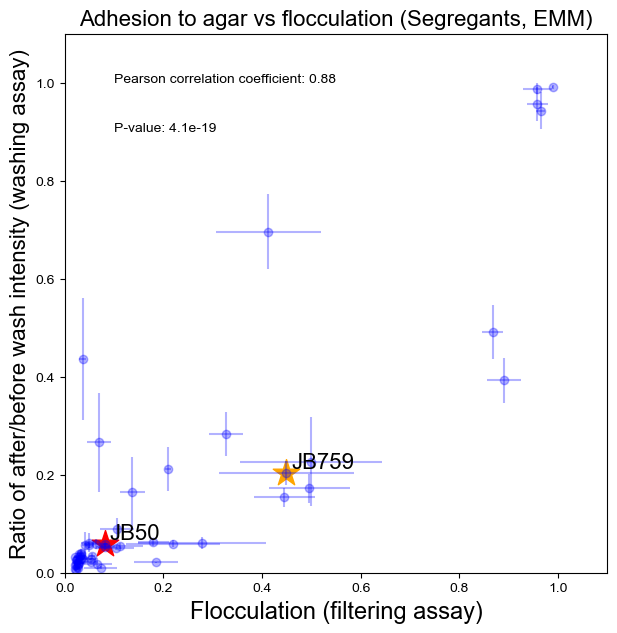

In [190]:
#create scatterplot of filtering vs phenotype and add error bars using sem values from ffiltering_phenotype Show X968 and Y0036 in red and yellow respectively both glyph and text
plt.figure(figsize=(7,7))
#put error bars in back
plt.errorbar(filtering_phenotype["%flocc"],filtering_phenotype["ratio"],xerr=filtering_phenotype["sem_x"],yerr=filtering_phenotype["sem_y"],fmt="o",color="blue",alpha=0.3)
plt.ylabel("Ratio of after/before wash intensity (washing assay)",fontsize=16)
plt.xlabel("Flocculation (filtering assay)",fontsize=17)
plt.title("Adhesion to agar vs flocculation (Segregants, EMM)",fontsize=16)
#make it pretty
plt.xlim(0,1.1)
plt.ylim(0,1.1)
#label  X968 and Y0036 filled with red and yellow respectively both glyph and text large dot
plt.text(filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["%flocc"]+0.01,filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["ratio"]+0.01,"JB50",color="black",fontsize=16)
plt.text(filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["%flocc"]+0.01,filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["ratio"]+0.01,"JB759",color="black",fontsize=16)
#bring these in front of the error bars

plt.scatter(filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["%flocc"],filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["ratio"],color="red",s=400,marker="*")
plt.scatter(filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["%flocc"],filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["ratio"],color="orange",s=400,marker="*")




#print also a spearman correlation coefficient and p value between the two variables
plt.text(0.1,1,"Pearson correlation coefficient: "+str(round(stats.pearsonr(filtering_phenotype["%flocc"],filtering_phenotype["ratio"])[0],2)))
plt.text(0.1,0.9,"P-value: "+str(round(stats.pearsonr(filtering_phenotype["%flocc"],filtering_phenotype["ratio"])[1],20)))
plt.show()



# Same plot but simpler (for presentation purposes)

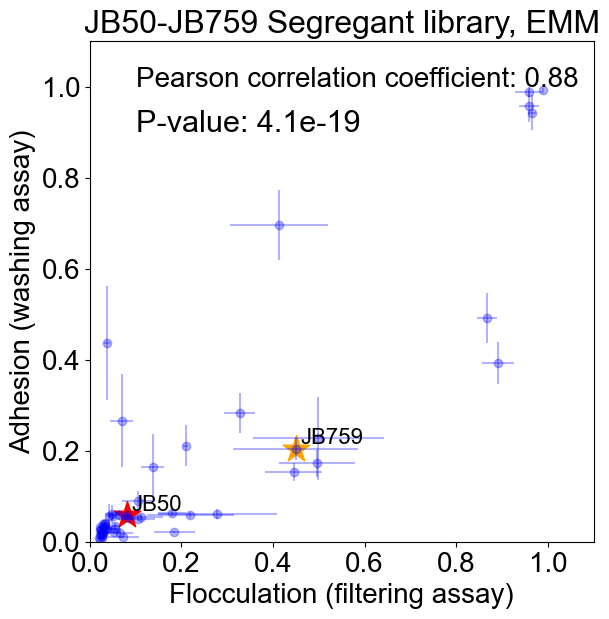

In [191]:
#create scatterplot of filtering vs phenotype and add error bars using sem values from ffiltering_phenotype Show X968 and Y0036 in red and yellow respectively both glyph and text
plt.figure(figsize=(6.5,6.5))
#put error bars in back
plt.errorbar(filtering_phenotype["%flocc"],filtering_phenotype["ratio"],xerr=filtering_phenotype["sem_x"],yerr=filtering_phenotype["sem_y"],fmt="o",color="blue",alpha=0.3)
plt.ylabel("Adhesion (washing assay)",fontsize=20)
plt.xlabel("Flocculation (filtering assay)",fontsize=20)
plt.title("JB50-JB759 Segregant library, EMM",fontsize=23)
#make it pretty
plt.xlim(0,1.1)
plt.ylim(0,1.1)
#label  X968 and Y0036 filled with red and yellow respectively both glyph and text large dot
plt.text(filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["%flocc"]+0.01,filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["ratio"]+0.01,"JB50",color="black",fontsize=16)
plt.text(filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["%flocc"]+0.01,filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["ratio"]+0.01,"JB759",color="black",fontsize=16)
#bring these in front of the error bars

plt.scatter(filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["%flocc"],filtering_phenotype[filtering_phenotype["Strain"]=="JB50"]["ratio"],color="red",s=400,marker="*")
plt.scatter(filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["%flocc"],filtering_phenotype[filtering_phenotype["Strain"]=="JB759"]["ratio"],color="orange",s=400,marker="*")

#larger ticks and tick labels
plt.tick_params(axis='both', which='major', labelsize=20)
plt.tick_params(axis='both', which='minor', labelsize=20)


#print also a spearman correlation coefficient and p value between the two variables
plt.text(0.1,1,"Pearson correlation coefficient: "+str(round(stats.pearsonr(filtering_phenotype["%flocc"],filtering_phenotype["ratio"])[0],2)),fontsize=20)
plt.text(0.1,0.9,"P-value: "+str(round(stats.pearsonr(filtering_phenotype["%flocc"],filtering_phenotype["ratio"])[1],20)),fontsize=22)

plt.savefig(root + "Figures/All figures/segregants adhesion flocculation corr.svg", format="svg",dpi=400)
plt.savefig(root + "Figures/All figures/segregants adhesion flocculation corr.png", format="png",dpi=400)

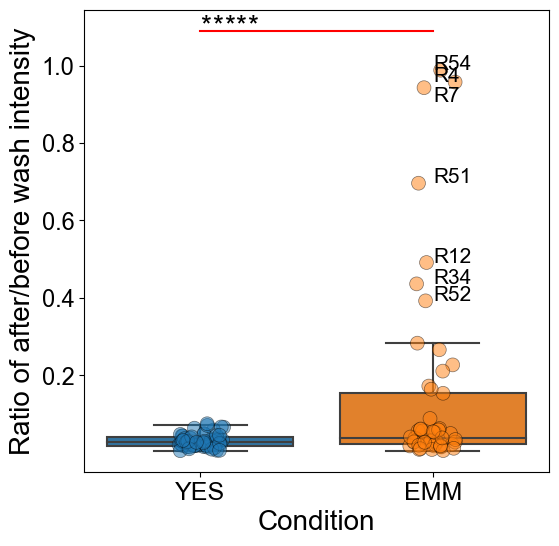

In [192]:

condition_plot_df = pd.concat([segregant_yes, segregant_emm])

condition_plot_df = condition_plot_df.reset_index(drop=True)
conditions = np.array([["YES"] * len(segregant_yes)])[0]

conditions = np.append(conditions, [["EMM"] * len(segregant_emm)])


condition_plot_df["condition"] = conditions
condition_plot_df["y_vals"] = condition_plot_df["ratio"]
#remove strains that start with JB and then reset index
condition_plot_df = condition_plot_df[~condition_plot_df["strain"].str.startswith("JB")]
#remove R45 and R48
condition_plot_df = condition_plot_df[~condition_plot_df["strain"].str.startswith("R45")]

condition_plot_df = condition_plot_df.reset_index(drop=True)

highest_strains = np.unique(condition_plot_df[condition_plot_df["ratio"]>0.3]["strain"])
subset_df = condition_plot_df[condition_plot_df["strain"].isin(highest_strains)]

#Make sns boxplot and overlaid stripplot of condition_plot_df with x=condition and y=ratio
conditions=[     "YES",
     "EMM"]
plt.figure(figsize=(6,6))
sns.boxplot(x="condition",y="ratio",data=condition_plot_df,showfliers=False)
#put black outline for circles
sns.stripplot(x="condition",y="ratio",data=condition_plot_df,jitter=True,size=10,linewidth=0.5,edgecolor="black",alpha=0.5)
plt.ylabel("Ratio of after/before wash intensity")
#draw bars between YES and all other conditions
for i in range(1,len(conditions)):
      #choose strain and ratio
      p1 = condition_plot_df[condition_plot_df["condition"]==conditions[0]][["strain","ratio"]]
      p2 = condition_plot_df[condition_plot_df["condition"]==conditions[i]][["strain","ratio"]]
      #create p3 by merging over strai
      p3 = pd.merge(p1,p2,on="strain")
      p3["diff"] = p3["ratio_x"]-p3["ratio_y"]
      #do t test
      s,p = stats.ttest_ind(p3["ratio_x"],p3["ratio_y"],permutations=1000000)
      
      if p<0.05:
            plt.plot([0,i],[i*0.03+1.06,i*0.03+1.06],color="red")
      #write as many asterisks as significant
      for j in range(int(np.log10(p**-1))):
            plt.text(j*0.05,i*0.03+1.05,"*",fontsize=20)
      if p>0.05:
            plt.text(0,i*0.03+1.05,"ns",fontsize=20)

#print the strain name for those with ratio>0.5
x_vals=[]
y_vals=[]

for i in range(len(condition_plot_df)):
      if condition_plot_df["ratio"][i]>0.3:
            #convert condition value to number
            condition = conditions.index(condition_plot_df["condition"][i])
            indices = [j for j, x in enumerate(x_vals) if x == condition and abs(y_vals[j]-condition_plot_df["y_vals"][i])<0.06]
            y_jitter=0
            while len(indices)>1:
                  
                  #move the larger index higher
                  
                  y_val_index_0 = y_vals[indices[0]]
                  if y_val_index_0>condition_plot_df["y_vals"][i]:
                        y_jitter = stats.norm.rvs(loc=0.02,scale=0.01)
                  else:
                        y_jitter = stats.norm.rvs(loc=-0.02,scale=0.01)
                  condition_plot_df["y_vals"][i] = condition_plot_df["y_vals"][i]+y_jitter
                  indices = [j for j, x in enumerate(x_vals) if x == condition and abs(y_vals[j]-condition_plot_df["y_vals"][i])<0.06]
            
            
            x_vals.append(condition)
            y_vals.append(condition_plot_df["y_vals"][i])
          

            plt.text(condition,condition_plot_df["y_vals"][i]+y_jitter,condition_plot_df["strain"][i],fontsize=15)

#larger ticks and labels
plt.xticks(fontsize=18)
plt.yticks(fontsize=17)
plt.xlabel("Condition",fontsize=20)
plt.ylabel("Ratio of after/before wash intensity",fontsize=20)
#only label y axis 0.2, 0.4, 0.6, 0.8, 1.0
plt.yticks([0.2,0.4,0.6,0.8,1.0])

plt.savefig(root + "Figures/All figures/segregants emm_yes.svg", format="svg",dpi=400)
plt.savefig(root + "Figures/All figures/segregants emm_yes.png", format="png",dpi=400)

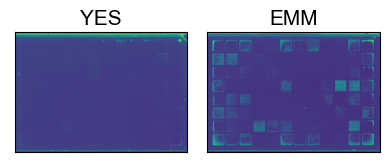

In [193]:

conds = ["YES", "EMM"]
# create a grid of subplots
fig, axs = plt.subplots(1, 2, figsize=(4, 5))

# loop over the conditions and plot the representative image for each condition
for i, ax in enumerate(axs):
    # get the folder name of the after wash images
    after_folder = root + "Internal data/imaging_adhesion/Segregants_" + conds[i] + "_after/"
    # show the 0th image in that folder
    representative_image(after_folder, 1,ax)
    # set the title as the condition
    #if "YES + Caffeine + Rapamycin", then change to "YES + Caf + Rap"
    ax.set_title(conds[i], fontsize=15)
    
    # remove the ticks
    ax.set_xticks([])
    ax.set_yticks([])
#tight layout
plt.tight_layout()
#save the figure
plt.savefig(root + "Figures/All figures/Representative images segregants.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/Representative images segregants.png", format="png", dpi=400)

# Plot on the wild isolates adhesion vs flocculation m



In [209]:
# Plot for wild isolates adhesion vs flocculation
wild_isolates_floc = pd.read_csv(root + "Bence folder/Plate_reader_assay/plate_reader_wild_isolates_results.csv",delimiter=",")

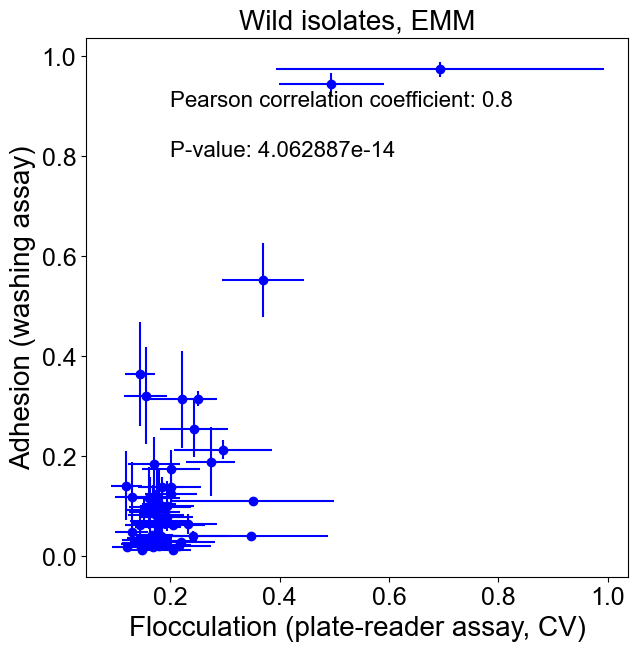

In [216]:
#wild_isolates_floc merge with phenotype_gwas
wild_isolates_floc_phenotype=wild_isolates_floc.merge(wild_isolate_emm,left_on="Strain",right_on="strain",how="inner")
#create scatterplot of filtering vs phenotype and add error bars using sem values from ffiltering_phenotype 
plt.figure(figsize=(7,7))
plt.errorbar(wild_isolates_floc_phenotype["CV"],wild_isolates_floc_phenotype["ratio"],xerr=wild_isolates_floc_phenotype["sem_x"],yerr=wild_isolates_floc_phenotype["sem_y"],fmt="o", color="blue")
plt.ylabel("Adhesion (washing assay)",fontsize=20)
plt.xlabel("Flocculation (plate-reader assay, CV)",fontsize=20)
plt.title("Wild isolates, EMM",fontsize=20)
#larger ticks
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)


#test spearman correlation coefficient and p value between the two variables
plt.text(0.2,0.9,"Pearson correlation coefficient: "+str(round(stats.pearsonr(wild_isolates_floc_phenotype["CV"],wild_isolates_floc_phenotype["ratio"])[0],2)),fontsize=16)
#also print p value
plt.text(0.2,0.8,"P-value: "+str(round(stats.pearsonr(wild_isolates_floc_phenotype["CV"],wild_isolates_floc_phenotype["ratio"])[1],20)),fontsize=16)

plt.savefig(root + "Figures/All figures/wild isolates adhesion flocc corr.svg", format="svg",dpi=400)
plt.savefig(root + "Figures/All figures/wild isolates adhesion flocc corr.png", format="png",dpi=400)



### simpler axes for presentation

Text(0.2, 0.8, 'P-value: 0.0034')

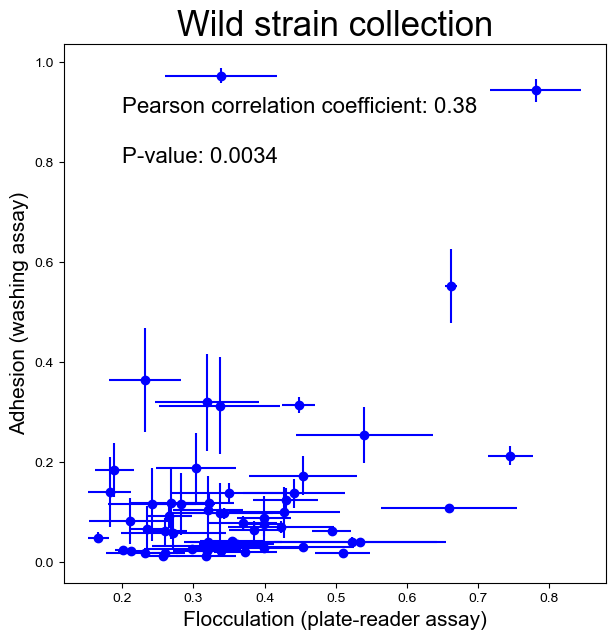

In [196]:
#wild_isolates_floc merge with phenotype_gwas
wild_isolates_floc_phenotype=wild_isolates_floc.merge(wild_isolate_emm,left_on="Strain",right_on="strain",how="inner")
#create scatterplot of filtering vs phenotype and add error bars using sem values from ffiltering_phenotype 
plt.figure(figsize=(7,7))
plt.errorbar(wild_isolates_floc_phenotype["Mean"],wild_isolates_floc_phenotype["ratio"],xerr=wild_isolates_floc_phenotype["SEM"],yerr=wild_isolates_floc_phenotype["sem"],fmt="o", color="blue")
plt.ylabel("Adhesion (washing assay)",fontsize=15)
plt.xlabel("Flocculation (plate-reader assay)",fontsize=15)
plt.title("Wild strain collection",fontsize=25)
#make it pretty

#test spearman correlation coefficient and p value between the two variables
plt.text(0.2,0.9,"Pearson correlation coefficient: "+str(round(stats.pearsonr(wild_isolates_floc_phenotype["Mean"],wild_isolates_floc_phenotype["ratio"])[0],2)),fontsize=16)
#also print p value
plt.text(0.2,0.8,"P-value: "+str(round(stats.pearsonr(wild_isolates_floc_phenotype["Mean"],wild_isolates_floc_phenotype["ratio"])[1],4)),fontsize=16)

In [197]:
# Plot of EMM vs YES for wild isolates
#phenotype_gwas merge with phenotype_yes
wi_emm_yes=wild_isolate_emm.merge(wild_isolate_yes,left_on="strain",right_on="strain",how="inner")
#remove entry with strain EMPTY
wi_emm_yes=wi_emm_yes[wi_emm_yes["strain"]!="EMPTY"]
#put values of ratio_x and ratio_y into one shared column and create a second that is called media with entries EMM and YES
ratio=np.concatenate((wi_emm_yes["ratio_x"],wi_emm_yes["ratio_y"]))
media = ["EMM"]*len(wi_emm_yes["ratio_x"])+["YES"]*len(wi_emm_yes["ratio_y"])
strains = np.concatenate((wi_emm_yes["strain"],wi_emm_yes["strain"]))
plot_df = pd.DataFrame({"ratio":ratio,"media":media,"strain":strains})

import iqplot 
import bokeh.io
bokeh.io.show(iqplot.strip(plot_df, q="ratio", cats="media", parcoord_column="strain", q_axis="y", title="EMM vs YES for wild isolates"))
#do a paired t-test between EMM and YES for wild isolates
stats.ttest_rel(wi_emm_yes["ratio_x"],wi_emm_yes["ratio_y"])


Ttest_relResult(statistic=2.828761623780379, pvalue=0.006406341844388846)

# Plotting segregant adhesion results when splitting by the most significant SNP

In [198]:
#Plotting the results when splitting at the most significant SNP
#read in snp data /Users/bencekover/Library/CloudStorage/OneDrive-UniversityCollegeLondon/MSci Bahler lab/S.-Pombe-biofilm/internal data/updated_genotype_matrix_final_pos.tsv
snps = pd.read_csv(root + "internal data/updated_genotype_matrix_final_pos.tsv",delimiter="\t")

seg_plot_df = filtering_phenotype.copy()
#remove R45 and R48
seg_plot_df = seg_plot_df[seg_plot_df["Strain"]!="R45"]
seg_plot_df = seg_plot_df[seg_plot_df["Strain"]!="R48"]

#rename strains JB50 to X968 and JB759 to Y0036
seg_plot_df["Strain"] = seg_plot_df["Strain"].replace("JB50","X968")
seg_plot_df["Strain"] = seg_plot_df["Strain"].replace("JB759","Y0036")

import re

# loop through each row in the DataFrame
for i, row in seg_plot_df.iterrows():
    # check if the strain name starts with "R" followed by a number
    if re.match(r"^R\d+$", row["Strain"]):
        # rename the strain by replacing "R" with "R1_"
        seg_plot_df.at[i, "Strain"] = "R1_" + row["Strain"][1:]

#reset index
seg_plot_df = seg_plot_df.reset_index(drop=True)


In [199]:
#in snps rename column 968 to X968
snps.rename(columns={"968":"X968"},inplace=True)
#keep only rows  2341 and 2431 in snps
snps=snps.iloc[[2341,2431,3540],:]
#reset
snps.reset_index(inplace=True,drop=True)
srb_geno = []
ncrna_geno = []
hsp_geno = []


#itearte through seg_plot_df
for i in range(len(seg_plot_df)):
      strain=seg_plot_df.iloc[i]["Strain"]
      #if strain is in snps colnames
      if strain in snps.columns:
            srb_geno.append(snps[strain][0])
            ncrna_geno.append(snps[strain][1])
            hsp_geno.append(snps[strain][2])

      else:
            srb_geno.append(np.nan)
            ncrna_geno.append(np.nan)
            hsp_geno.append(np.nan)
seg_plot_df["srb_geno"]=srb_geno
seg_plot_df["ncrna_geno"]=ncrna_geno
seg_plot_df["hsp_geno"]=hsp_geno
seg_plot_df["srb_geno_jitter"]=seg_plot_df["srb_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
seg_plot_df["ncrna_geno_jitter"]=seg_plot_df["ncrna_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
seg_plot_df["hsp_geno_jitter"]=seg_plot_df["hsp_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
#newly sequenced if in R1_34, R1_44, R1_48, R1_49,R1_50, R1_51, R1_52, R1_53 and R1_54
seg_plot_df["newly_sequenced"]=seg_plot_df["Strain"].isin(["R1_34", "R1_44", "R1_48", "R1_49","R1_50", "R1_51", "R1_52", "R1_53", "R1_54"])

#reset index
seg_plot_df.reset_index(inplace=True,drop=True)



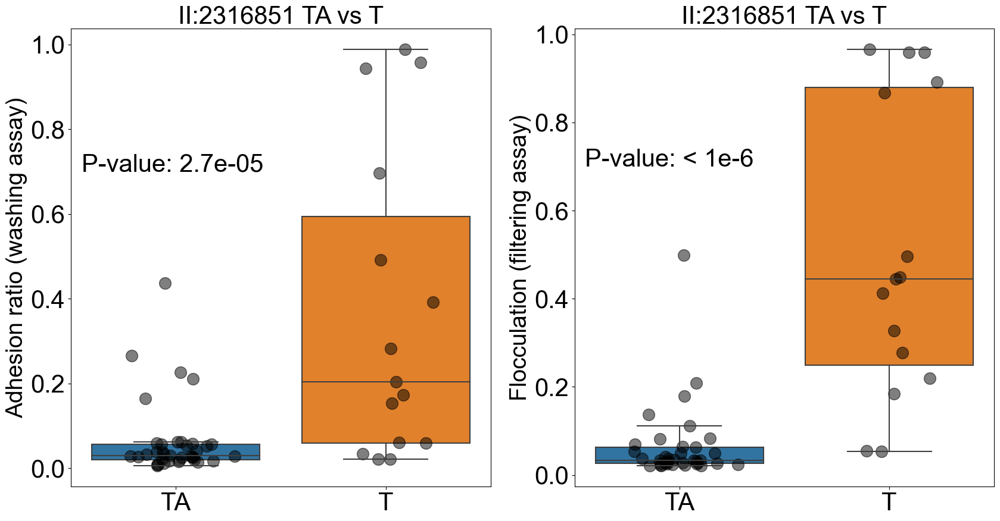

In [200]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

# plot the first plot
sns.boxplot(x="srb_geno", y="ratio", data=seg_plot_df, ax=ax[0], showfliers=False)
sns.scatterplot(x="srb_geno_jitter", y="ratio", data=seg_plot_df, ax=ax[0], color="black", s=200, edgecolor="black", alpha=0.5)

ax[0].set_title("II:2316851 TA vs T", fontsize=30)
ax[0].set_xlabel("", fontsize=30)
ax[0].set_xticklabels(["TA", "T"], fontsize=30)
ax[0].set_ylabel("Adhesion ratio (washing assay)", fontsize=28)
ax[0].tick_params(axis='y', labelsize=30)
ax[0].text(-0.45, 0.7, "P-value: " + str(round(stats.ttest_ind(seg_plot_df[seg_plot_df["srb_geno"] == 0]["ratio"], seg_plot_df[seg_plot_df["srb_geno"] == 1]["ratio"], permutations=1000000)[1], 10)), fontsize=30)

# plot the second plot
sns.boxplot(x="srb_geno", y="%flocc", data=seg_plot_df, ax=ax[1], showfliers=False)
sns.scatterplot(x="srb_geno_jitter", y="%flocc", data=seg_plot_df, ax=ax[1], color="black", s=200, edgecolor="black", alpha=0.5)

ax[1].set_title("II:2316851 TA vs T", fontsize=30)
ax[1].set_xlabel("", fontsize=30)
ax[1].set_xticklabels(["TA", "T"], fontsize=30)
ax[1].set_ylabel("Flocculation (filtering assay)", fontsize=28)
ax[1].tick_params(axis='y', labelsize=30)
#if p value less than what can be determined using the permutation test, say that it is less than 1e-6
p_val = stats.ttest_ind(seg_plot_df[seg_plot_df["srb_geno"] == 0]["%flocc"], seg_plot_df[seg_plot_df["srb_geno"] == 1]["%flocc"], permutations=1000000)[1]
if p_val < 1e-6:
    ax[1].text(-0.45, 0.7, "P-value: < 1e-6", fontsize=30)
else:
    ax[1].text(-0.45, 0.7, "P-value: " + str(round(p_val, 10)), fontsize=30)


plt.savefig(root + "Figures/All figures/segregants adhesion flocc snp.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/segregants adhesion flocc snp.png", format="png", dpi=400)

# Now splitting EMM-P data by the chr I inversion


In [201]:
#Plotting the results when splitting at the most significant SNP
#read in snp data /Users/bencekover/Library/CloudStorage/OneDrive-UniversityCollegeLondon/MSci Bahler lab/S.-Pombe-biofilm/internal data/updated_genotype_matrix_final_pos.tsv
snps = pd.read_csv(root + "internal data/updated_genotype_matrix_final_pos.tsv",delimiter="\t")

seg_plot_df = segregant_emm_p.copy()
#remove R45 and R48
seg_plot_df = seg_plot_df[seg_plot_df["strain"]!="R1_45"]
seg_plot_df = seg_plot_df[seg_plot_df["strain"]!="R1_48"]



#reset index
seg_plot_df = seg_plot_df.reset_index(drop=True)

#keep only row 900
snps=snps.iloc[[900],:]
#reset
snps.reset_index(inplace=True,drop=True)
inv_geno = []


#itearte through seg_plot_df
for i in range(len(seg_plot_df)):
      strain=seg_plot_df.iloc[i]["strain"]
      #if strain is in snps colnames
      if strain in snps.columns:
            inv_geno.append(snps[strain][0])

      else:
            inv_geno.append(np.nan)
seg_plot_df["inv_geno"]=inv_geno
seg_plot_df["inv_geno_jitter"]=seg_plot_df["inv_geno"]+np.random.normal(0,0.1,len(seg_plot_df))
#newly sequenced if in R1_34, R1_44, R1_48, R1_49,R1_50, R1_51, R1_52, R1_53 and R1_54
seg_plot_df["newly_sequenced"]=seg_plot_df["strain"].isin(["R1_34", "R1_44", "R1_48", "R1_49","R1_50", "R1_51", "R1_52", "R1_53", "R1_54"])

#reset index
seg_plot_df.reset_index(inplace=True,drop=True)



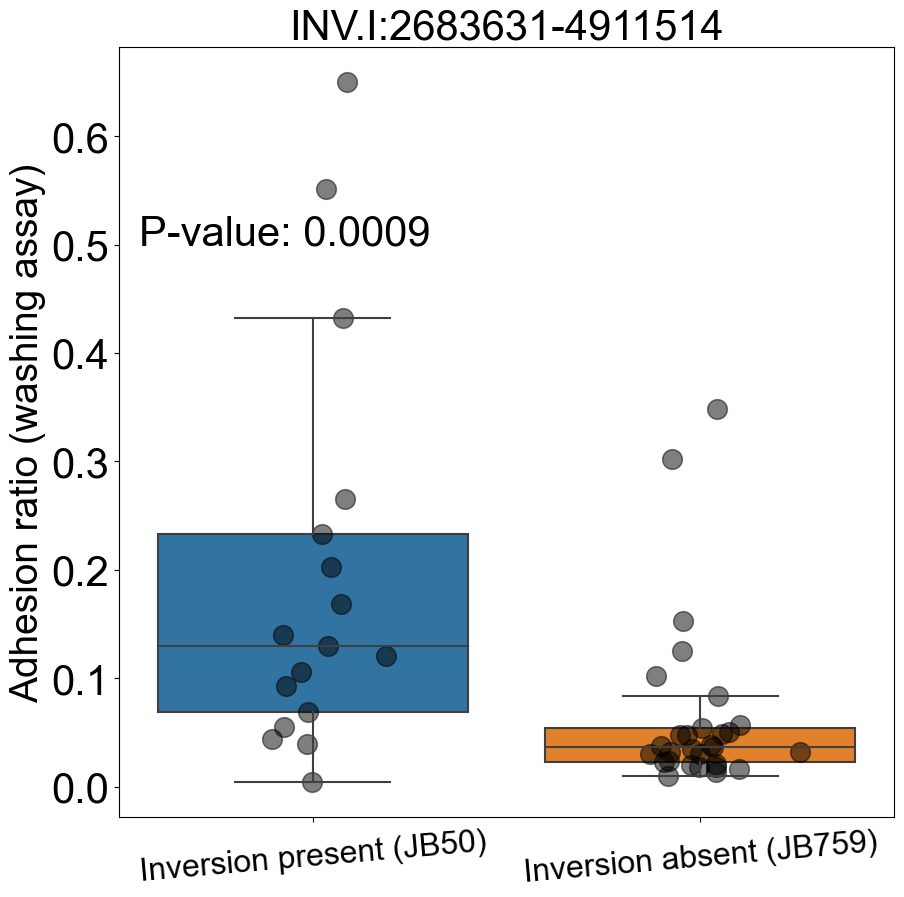

In [202]:
fig, ax = plt.subplots(figsize=(10, 10))

# plot the first plot
sns.boxplot(x="inv_geno", y="ratio", data=seg_plot_df, ax=ax, showfliers=False)
sns.scatterplot(x="inv_geno_jitter", y="ratio", data=seg_plot_df, ax=ax, color="black", s=200, edgecolor="black", alpha=0.5)

ax.set_title("INV.I:2683631-4911514", fontsize=30)
ax.set_xlabel("", fontsize=30)
ax.set_xticklabels(["Inversion present (JB50)", "Inversion absent (JB759)"], fontsize=23)
#rotate ticks
plt.xticks(rotation=5)
ax.set_ylabel("Adhesion ratio (washing assay)", fontsize=28)
ax.tick_params(axis='y', labelsize=30)
ax.text(-0.45, 0.5, "P-value: " + str(round(stats.ttest_ind(seg_plot_df[seg_plot_df["inv_geno"] == 0]["ratio"], seg_plot_df[seg_plot_df["inv_geno"] == 1]["ratio"], permutations=10000)[1], 10)), fontsize=30)



plt.savefig(root + "Figures/All figures/segregants adhesion flocc snp emm_p.svg", format="svg", dpi=400)
plt.savefig(root + "Figures/All figures/segregants adhesion flocc snp emm_p.png", format="png", dpi=400)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
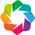

Python implementation: CPython
Python version       : 3.9.0
IPython version      : 7.31.1

numpy     : 1.21.6
pandas    : 1.4.4
scipy     : 1.7.3
bokeh     : 2.4.0
iqplot    : 0.3.3
bebi103   : 0.1.11
jupyterlab: 3.5.3



In [203]:
%load_ext watermark
%watermark -v -p numpy,pandas,scipy,bokeh,iqplot,bebi103,jupyterlab